In this project I implement several techniquies to find lane lines and calculate their curvature and position of camera in relation to the lane line.

In order to acomplish the final goal of correctly identifing the lane lines and other factors in a video of real world driving I approached it in this order.
    1. Use a 9x6 chessboard and opencv's camera calibration function to identify image points on the chessboard.
    2. Use the previous found image points to undistort/distort images/frames.
    3. Perform various transformations and thresholding to better identify lane lines
    4. Identify region of interest and warp the image into a birds eye view image to better identify lane lines only
    5. Perform convolution on image and identify lane path by finding a center line through center of each filter.
    6. Lastly to prepare for a video save last 10-15 frames and add them to stabilize and improve efficiency of detection.

<h1>Camera Calibration</h1>

In [1]:
import numpy as np
import cv2
import glob
import pickle
import matplotlib.pyplot as plt
%matplotlib inline

objp = np.zeros((6*9, 3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/*.jpg')
# print(images)

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
#     print(fname)
    file_name = fname.split('/')[-1]
#     print(file_name)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        write_name = './output_images/' + file_name
#         print(write_name)
        cv2.imwrite(write_name, img)        
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        #plt.imshow(img)

In [2]:
# Load image for reference
img = cv2.imread('./camera_cal/calibration2.jpg')
img_size = (img.shape[1], img.shape[0])

In [3]:
def undistort(image):
    return cv2.undistort(image, mtx, dist, None, mtx)

# Perform calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

dst = cv2.imread('./output_images/calibration2.jpg')
dst = undistort(dst)

# Save the  calibration result for later use
dist_pickle = {}
dist_pickle['mtx'] = mtx
dist_pickle['dist'] = dist
pickle.dump(dist_pickle, open('./calibrate.p', 'wb'))

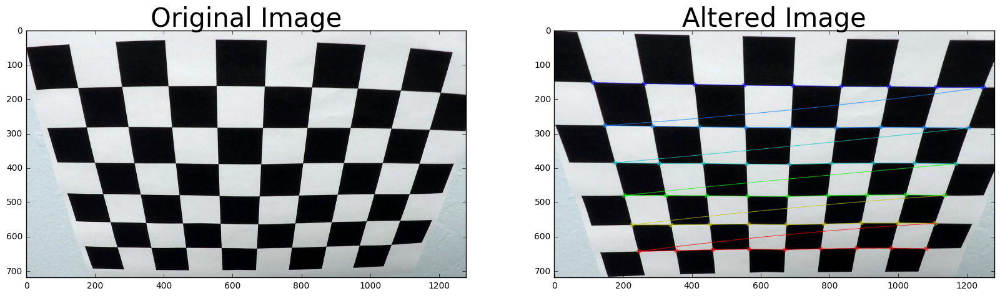

In [4]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Altered Image', fontsize=30)

In the image above it may be hard to see, but if you look in the top left corner of each image you can see how distortion is removed and then important measurement lines are taken and drawn from each row of the chessboard. 

<h1>Pipeline for Test Images</h1>

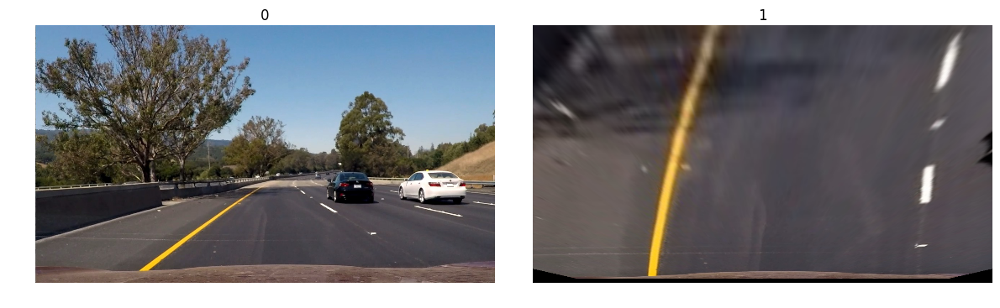

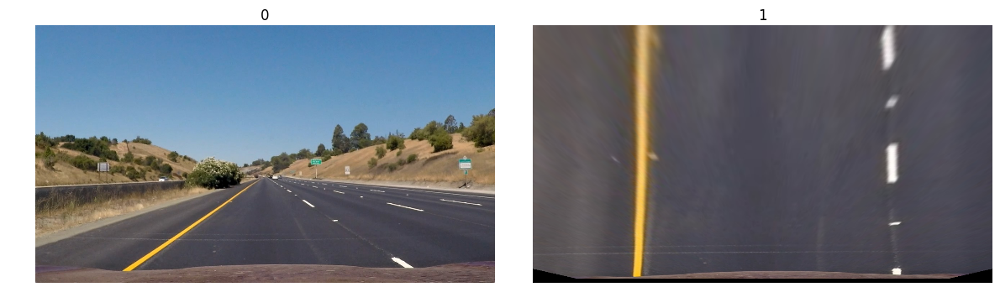

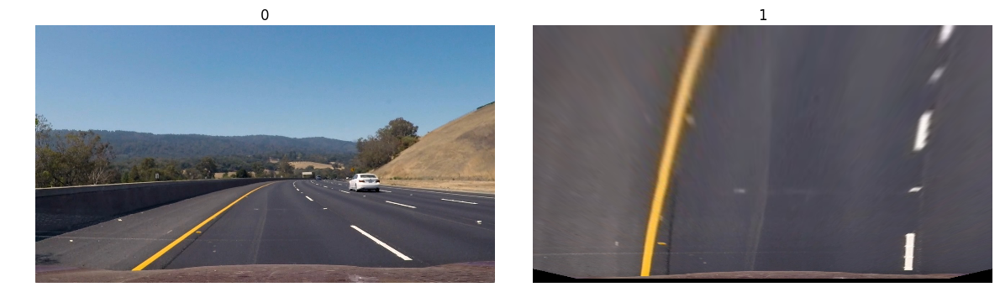

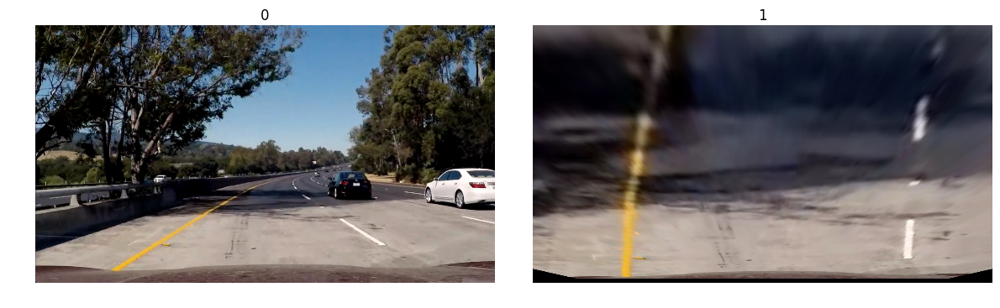

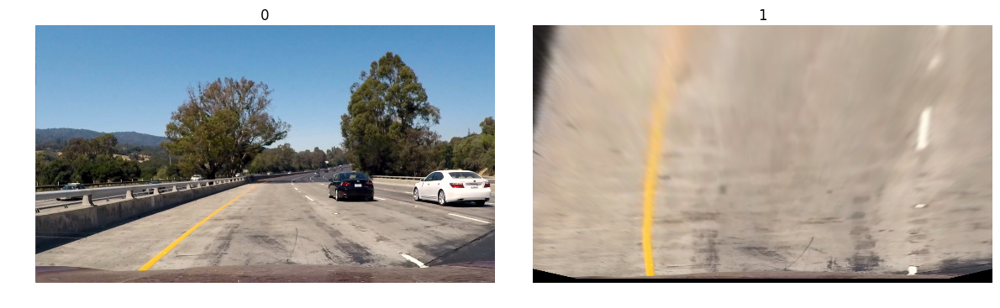

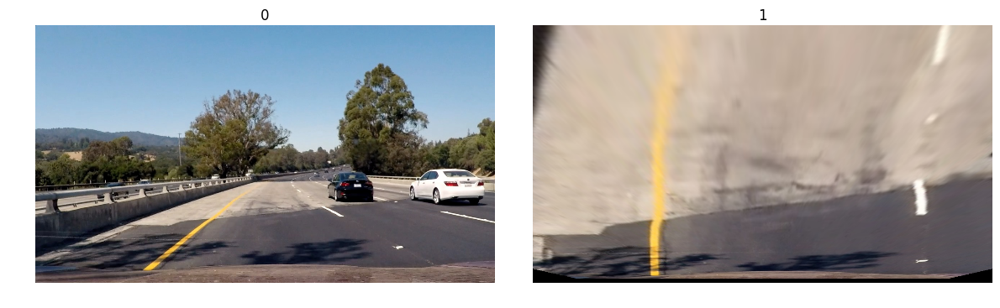

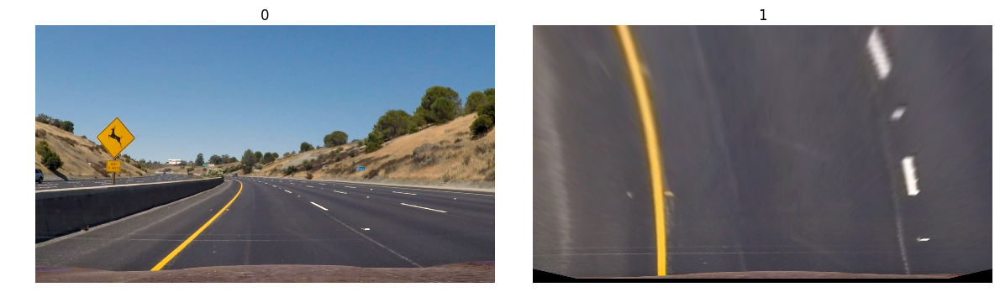

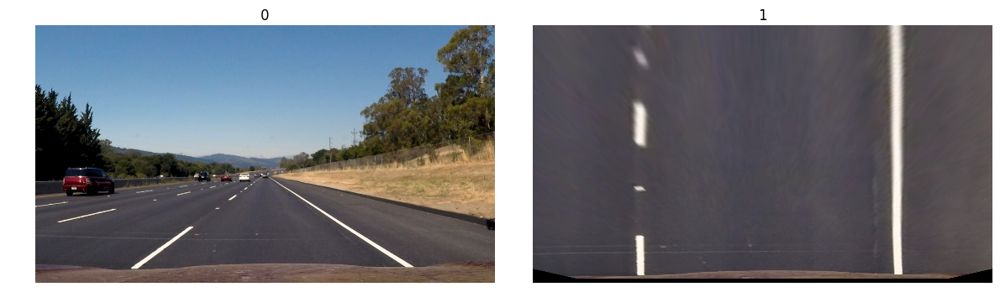

In [5]:
def plot_figures(figures, nrows = 1, ncols=1, labels=None, show_axis=False):
    fig, axs = plt.subplots(ncols=ncols, nrows=nrows, figsize=(12, 10))
    axs = axs.ravel()
    for index, title in zip(range(len(figures)), figures):
        axs[index].imshow(figures[title], plt.gray())
        if(labels != None):
           axs[index].set_title(labels[index])
        else:
            axs[index].set_title(title)

        axs[index].set_axis_off()

    plt.tight_layout()
    
def load_calibration():
    dist_pickle = pickle.load(open('./calibrate.p', "rb"))
    return dist_pickle['mtx'], dist_pickle['dist']

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, abs_thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # 3) Take the absolute value of the derivative or gradient
    abs_sobelx = np.absolute(abs_sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= abs_thresh[0]) & (scaled_sobel <= abs_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return sxbinary

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # 5) Create a binary mask where mag thresholds are met
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return binary_output

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    sobel_absx = np.absolute(sobelx)
    sobel_absy = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    sobel_arc = np.arctan2(sobel_absy, sobel_absx)
    # 5) Create a binary mask where direction thresholds are met
    binary_mask = np.zeros_like(sobel_arc)
    # 6) Return this mask as your binary_output image
    binary_mask[(sobel_arc >= thresh[0]) & (sobel_arc <= thresh[1])] = 1
    return binary_mask

def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    img_hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    img_s_channel = img_hls[:,:,2]
    # 2) Apply a threshold to the S channel
    binary_output = np.zeros_like(img_s_channel)
    binary_output[(img_s_channel > thresh[0]) & (img_s_channel <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output

def hsv_select(image,thresh=(0,255)):
    hsv = cv2.cvtColor(image,cv2.COLOR_RGB2HSV)
    v = hsv[:,:,2]
    binary_output = np.zeros_like(v)
    binary_output[(v > thresh[0]) & (v<=thresh[1])] = 1
    return binary_output

def combine(image):
    sobel = abs_sobel_thresh(image, orient='x', sobel_kernel=9, abs_thresh=(30,100))
    s_hls = hls_select(image, thresh=(90, 255))
    v_hsv = hsv_select(image, thresh=(75,255))
    binary_warped = np.zeros_like(sobel)
    binary_warped[(sobel==1)|(s_hls==1) & (v_hsv ==1)]=1
    return binary_warped

def measure_curve(ploty,leftx,lefty,rightx,righty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m
    radius = (left_curverad+right_curverad)/2
    print(radius)
    return radius

def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    warped = image
#     plt.imshow(warped)
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(warped[int(3*warped.shape[0]/4):,:int(warped.shape[1]/2)], axis=0)
#     print(l_sum)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(warped[int(3*warped.shape[0]/4):,int(warped.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(warped.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(warped.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(warped[int(warped.shape[0]-(level+1)*window_height):int(warped.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,warped.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,warped.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

def pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary

# src = np.float32(
#     [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
#     [((img_size[0] / 6) - 10), img_size[1]],
#     [(img_size[0] * 5 / 6) + 60, img_size[1]],
#     [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
# dst = np.float32(
#     [[(img_size[0] / 4), 0],
#     [(img_size[0] / 4), img_size[1]],
#     [(img_size[0] * 3 / 4), img_size[1]],
#     [(img_size[0] * 3 / 4), 0]])

src = np.float32(
    [[200, 700],
     [1080, 700],
     [570, 460],
     [710, 460]]
)

dst = np.float32(
    [[260, 700],
     [1020, 700],
     [240, 0],
     [1040, 0]]
)
# src = np.float32([
#     [585,460],
#     [203,720],
#     [1127,720],
#     [695,460]])
# dst = np.float32([
#     [320,0],
#     [320,720],
#     [960,720],
#     [960,0]])

M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)

#undistort test images
original_figures = {}
undistorted_figures = {}
mtx, dist = load_calibration()
for i, filename in enumerate(glob.glob('./test_images/*.jpg')):
    img = cv2.imread(filename)
    original_figures[i] = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = undistort(img)
    
    undistort_name = './output_images/undistorted' + str(i + 1) + '.jpg'
    cv2.imwrite(undistort_name, img)
    
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    undistorted_figures[i] = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)
    
    perspective_name = './output_images/undistorted_perspective_transform' + str(i + 1) + '.jpg'
    cv2.imwrite(perspective_name, undistorted_figures[i])
#     plt.imshow(warped)

print_figures = {}
count = 0
for i in range(len(original_figures)):
    print_figures[count] = original_figures[i]
    print_figures[count+1] = undistorted_figures[i]
    plot_figures(print_figures, 1, 2)
    count = 0

Original test image on the left and perspective transform(birds eye view) distored image on the right. 

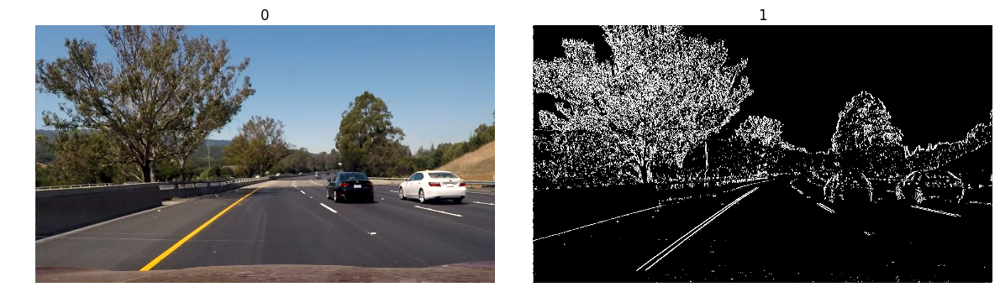

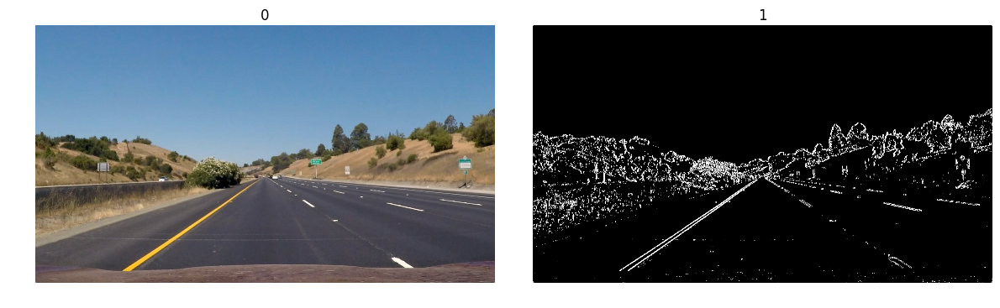

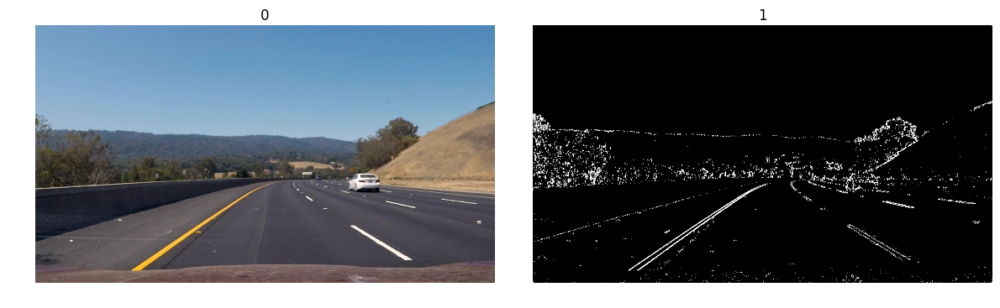

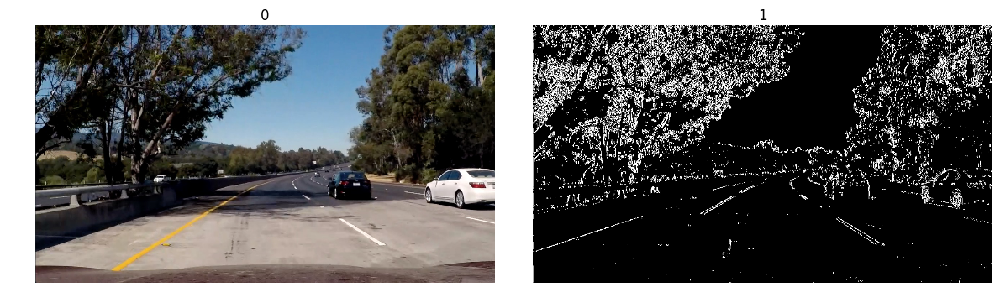

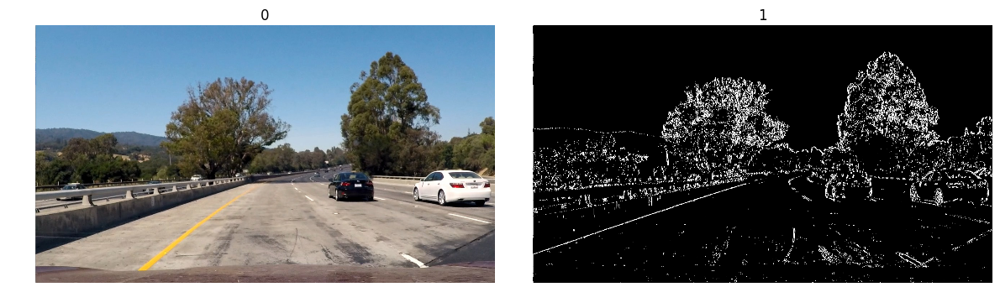

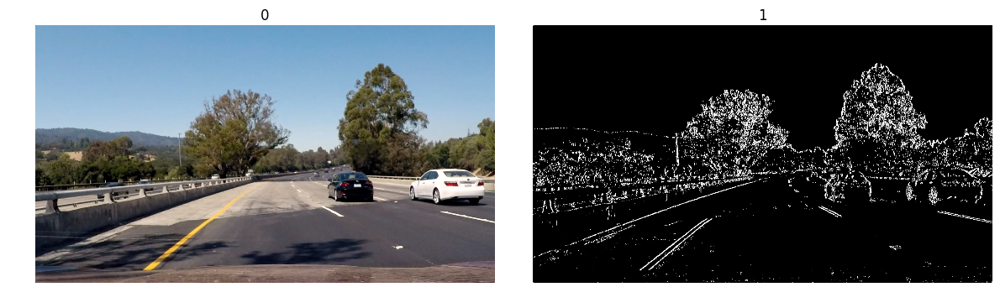

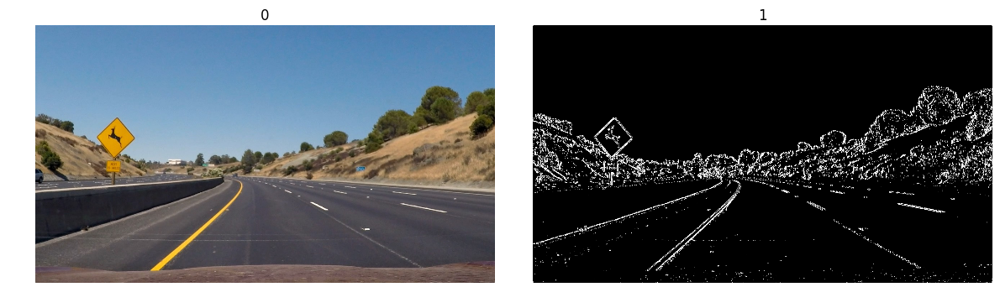

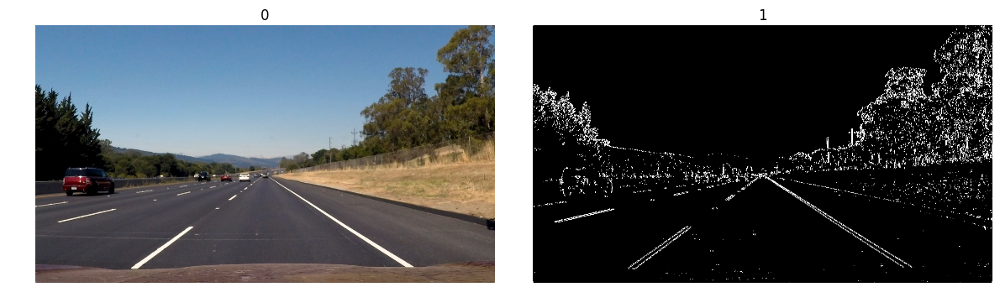

In [6]:
print_figures = {}
count = 0
for i in range(len(original_figures)):
    gradx = abs_sobel_thresh(original_figures[i], orient='x', sobel_kernel=3, abs_thresh=(20, 100))
    print_figures[count] = original_figures[i]
    print_figures[count+1] = gradx
    plot_figures(print_figures, 1, 2)
    count = 0

ABS Sobel threshold image on the right and original on the left.  This is using the x orient.

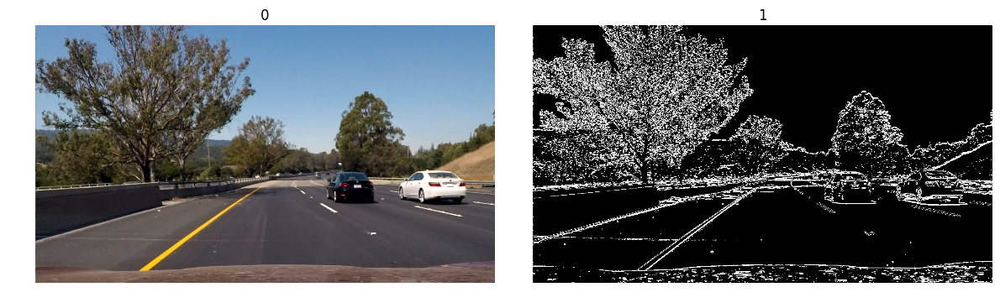

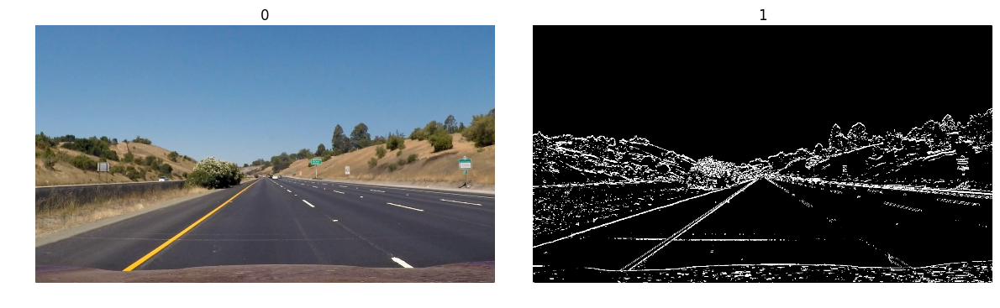

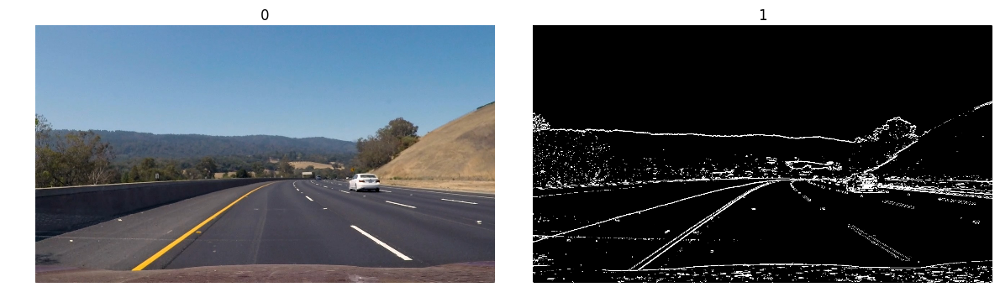

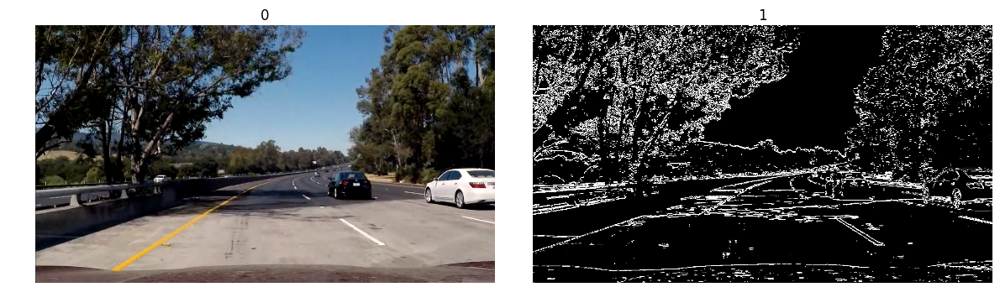

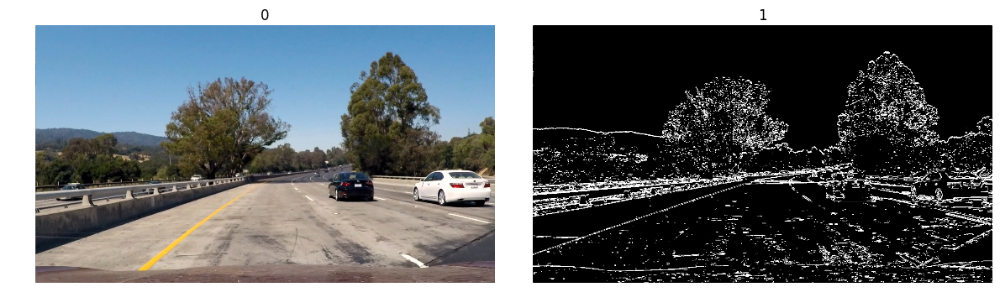

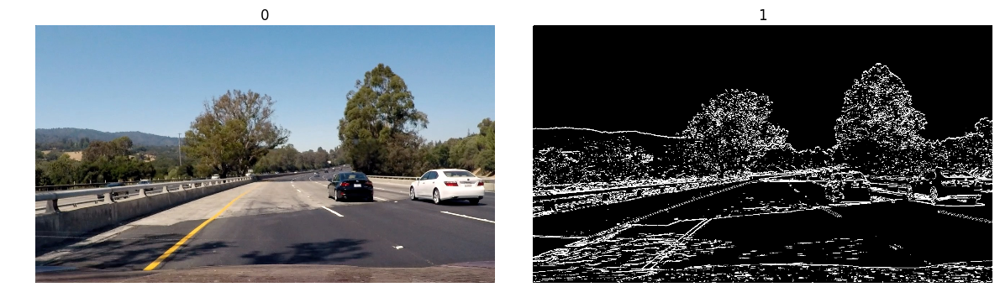

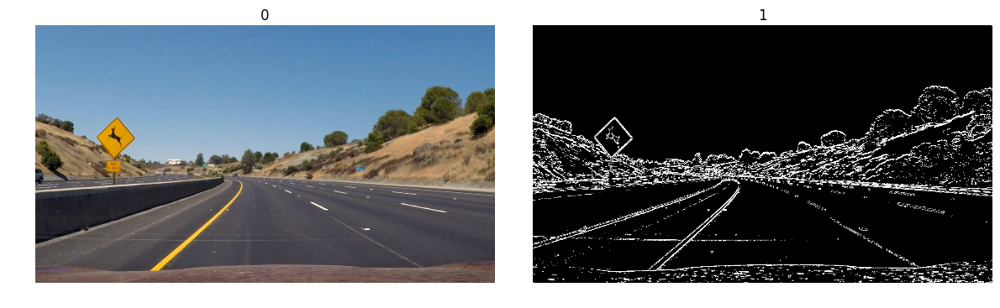

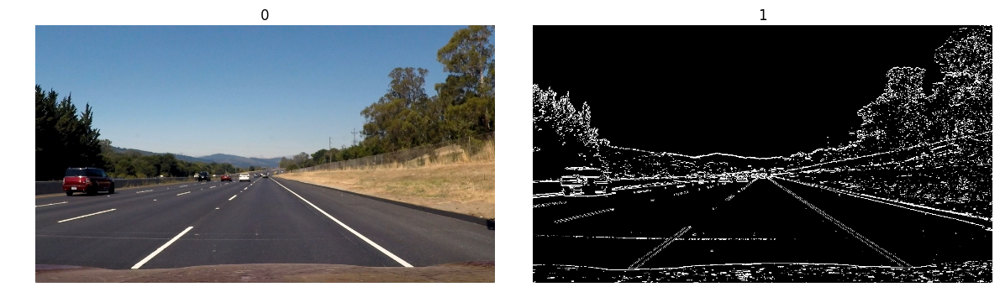

In [7]:
print_figures = {}
count = 0
for i in range(len(original_figures)):
    grady = abs_sobel_thresh(original_figures[i], orient='y', sobel_kernel=3, abs_thresh=(20, 100))
    print_figures[count] = original_figures[i]
    print_figures[count+1] = grady
    plot_figures(print_figures, 1, 2)
    count = 0    

Another ABS Sobel thresh and original on the left.  This uses a y orient. 

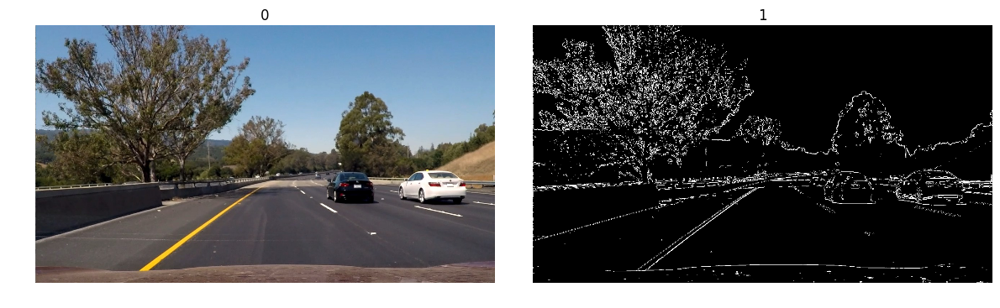

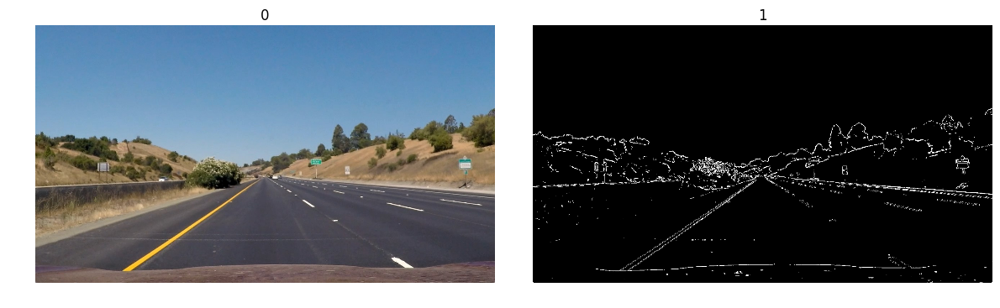

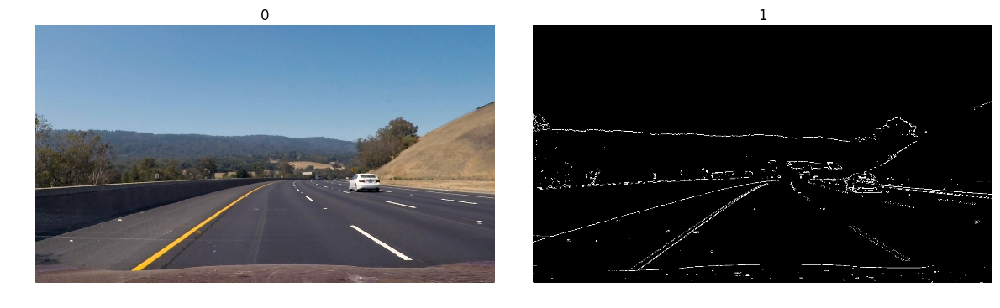

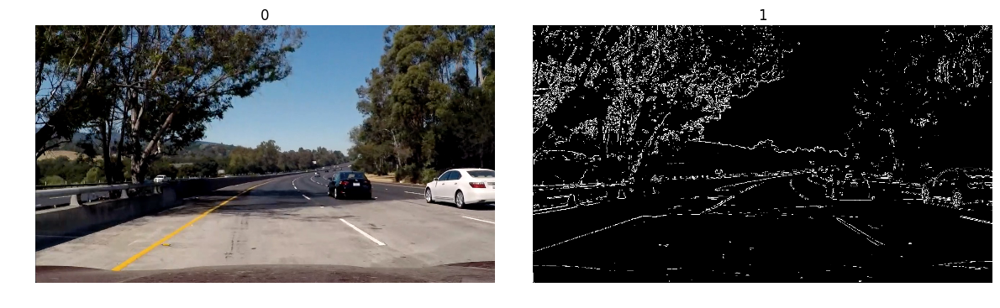

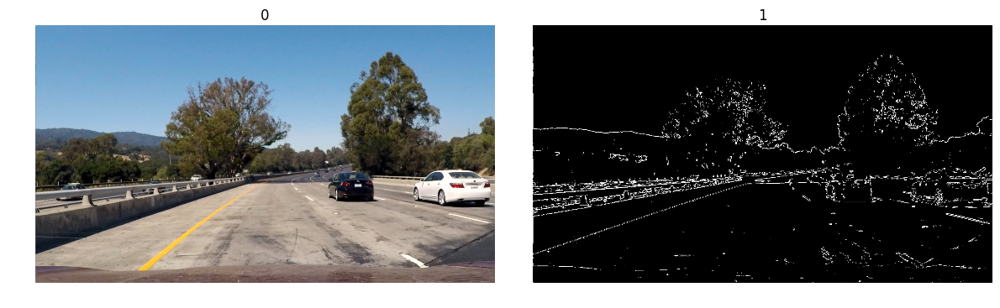

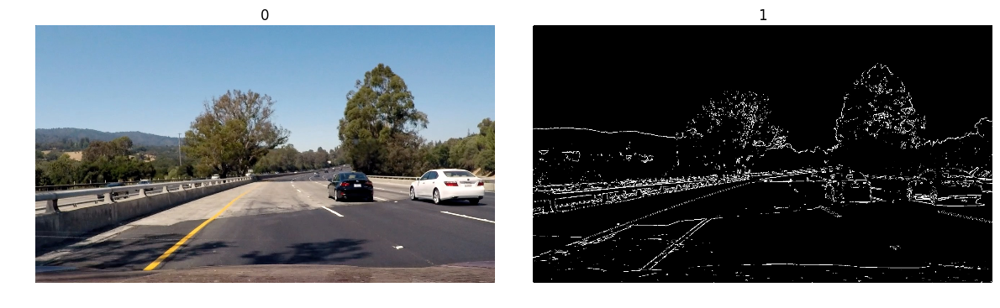

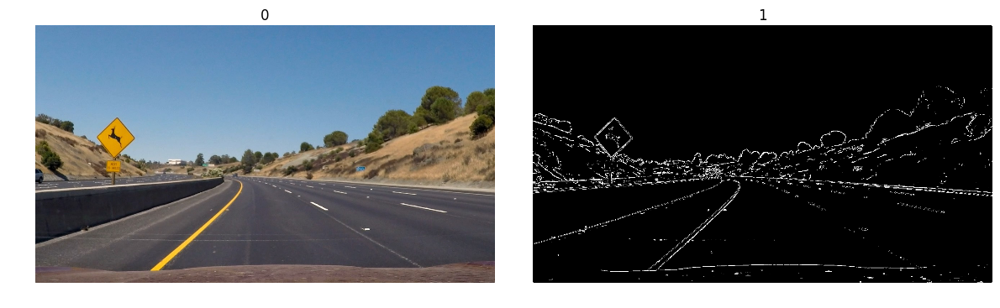

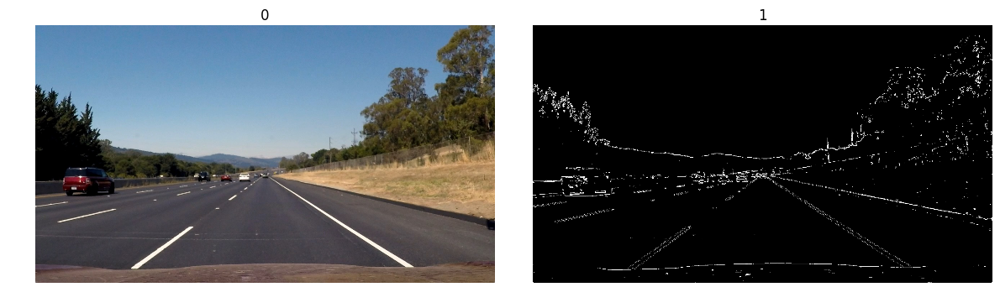

In [8]:
print_figures = {}
count = 0
for i in range(len(original_figures)):
    mag_binary = mag_thresh(original_figures[i], sobel_kernel=3, mag_thresh=(50, 100))
    print_figures[count] = original_figures[i]
    print_figures[count+1] = mag_binary
    plot_figures(print_figures, 1, 2)
    count = 0

Original on the left with the Magnitude of the Gradient image on the right.

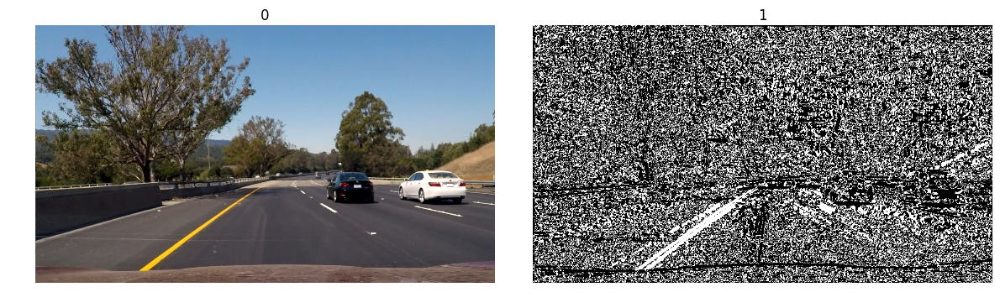

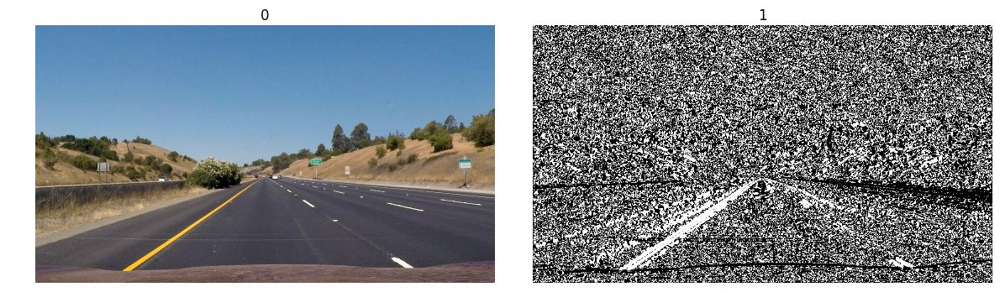

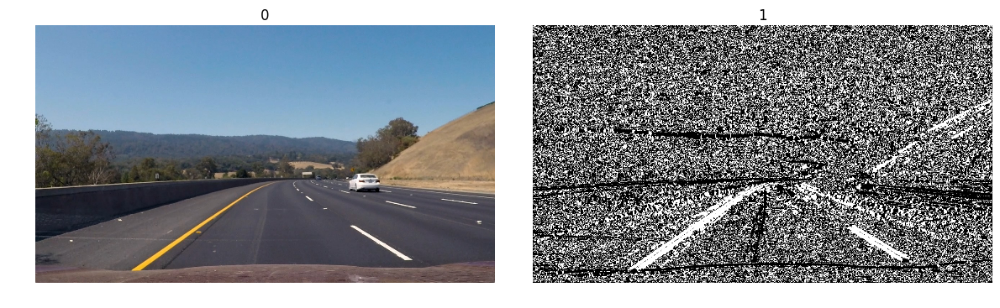

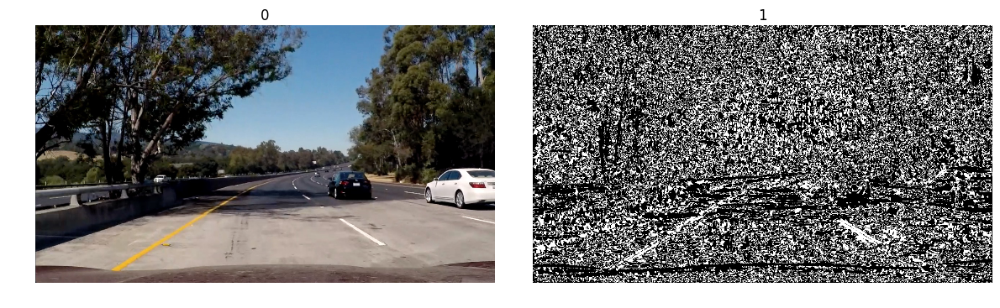

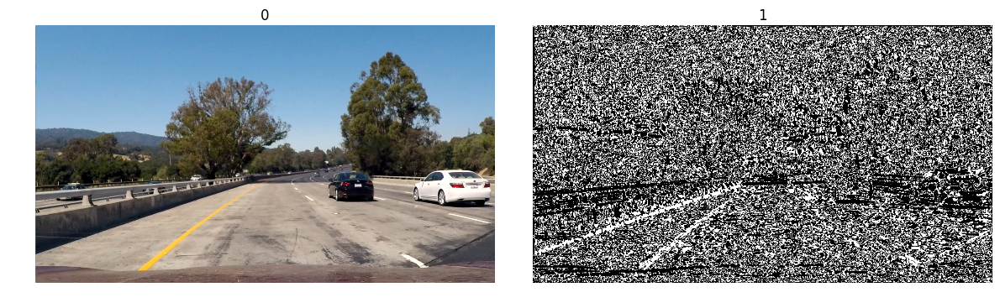

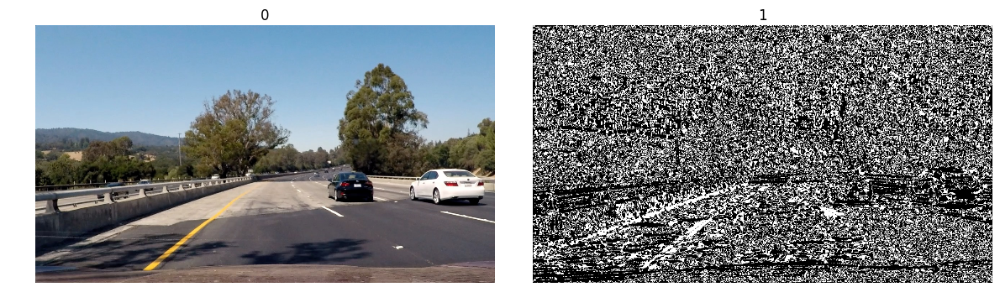

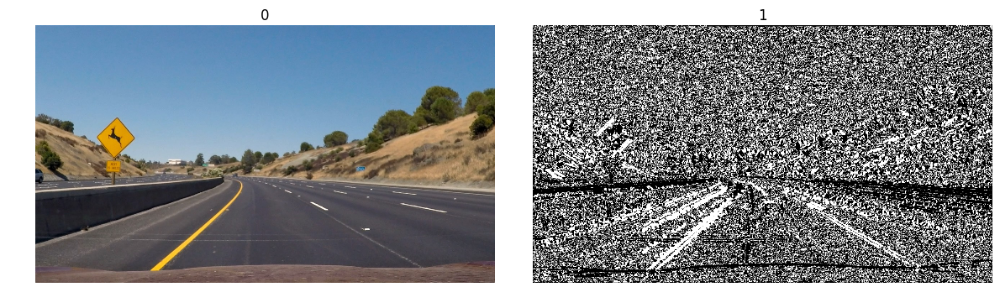

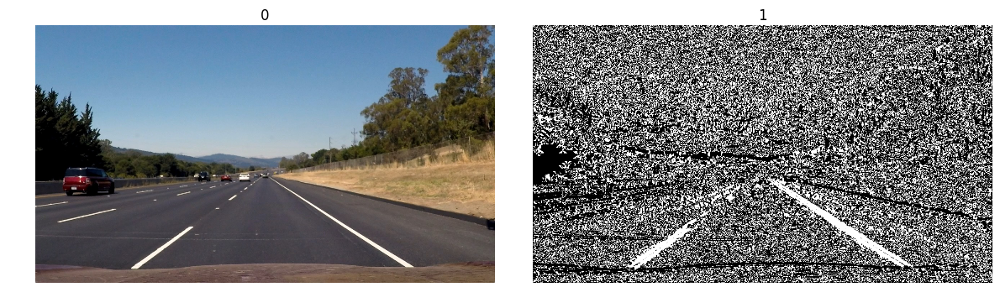

In [9]:
print_figures = {}
count = 0
for i in range(len(original_figures)):
    dir_binary = dir_threshold(original_figures[i], sobel_kernel=15, thresh=(0.7, 1.3))
    print_figures[count] = original_figures[i]
    print_figures[count+1] = dir_binary
    plot_figures(print_figures, 1, 2)
    count = 0

Original on the left with the Direction of the Gradient on the right.

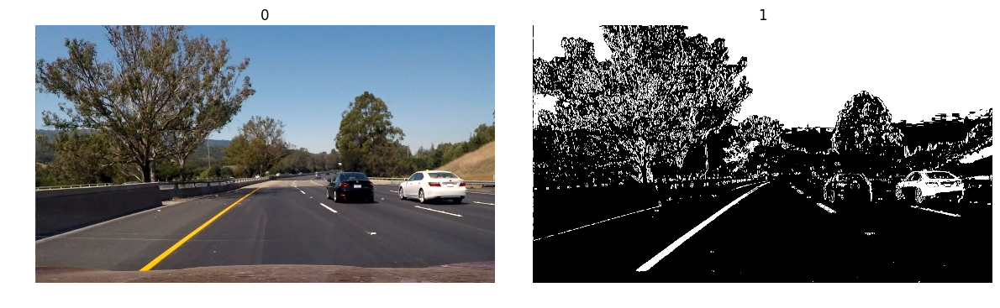

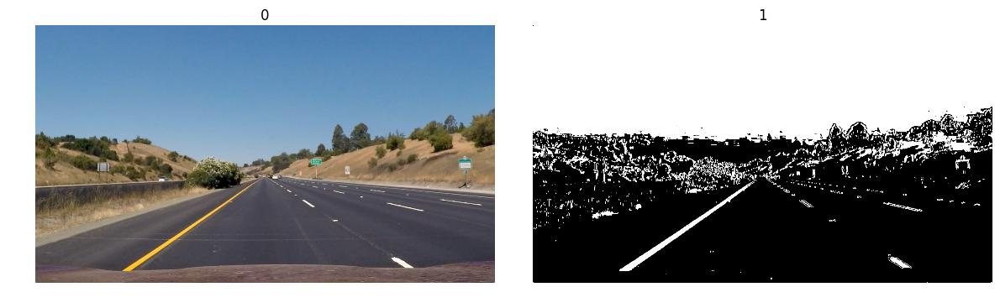

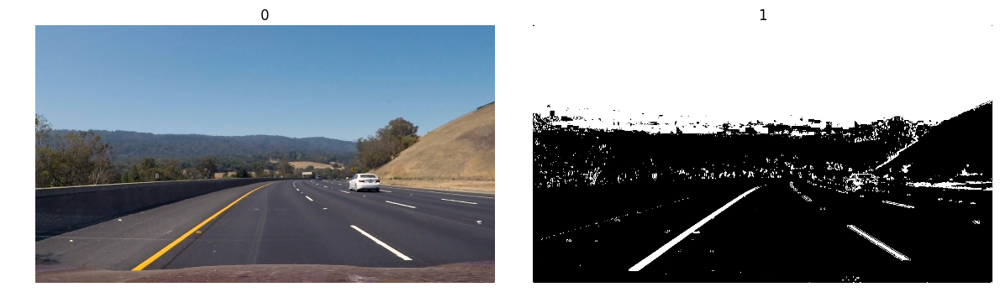

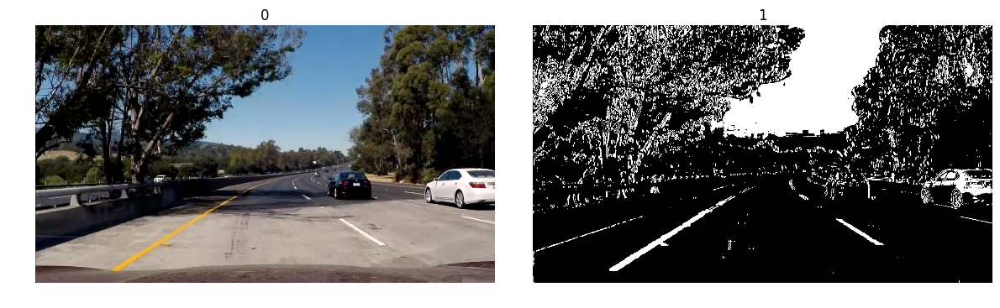

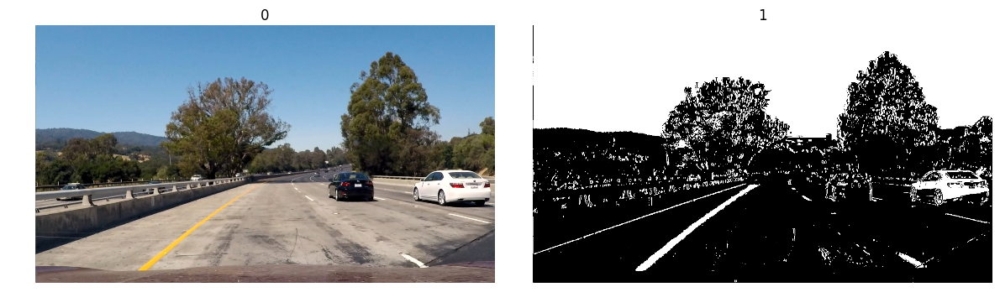

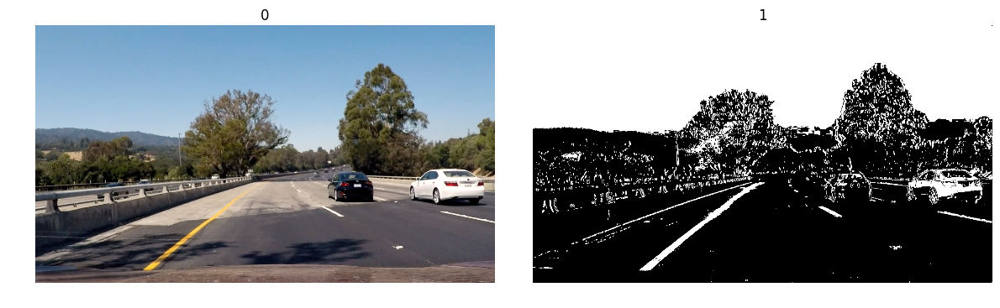

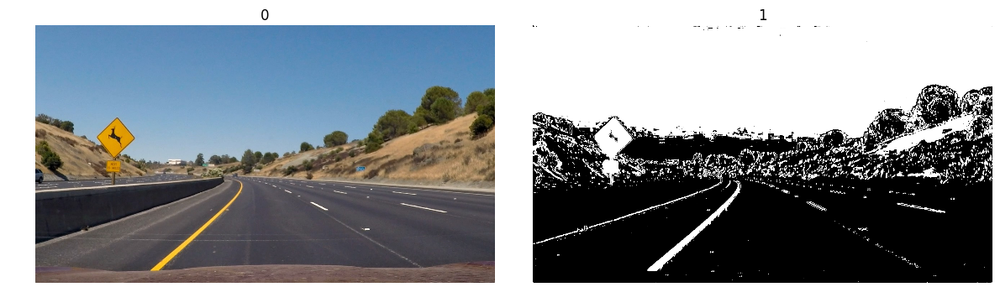

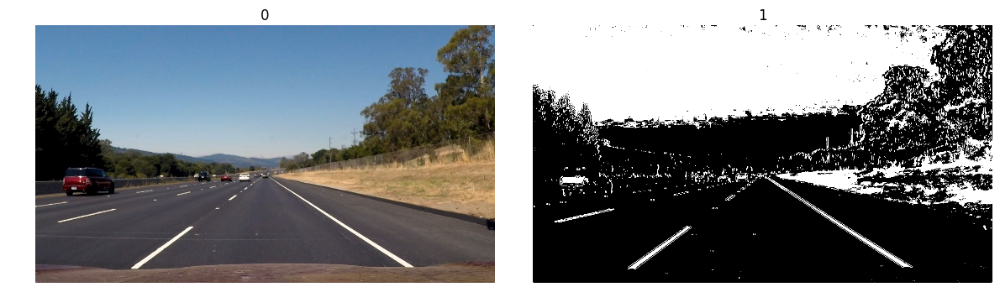

In [10]:
print_figures = {}
count = 0
for i in range(len(original_figures)):
    # Apply each of the thresholding functions
    combined = combine(original_figures[i])
#     gradx = abs_sobel_thresh(original_figures[i], orient='x', sobel_kernel=3, abs_thresh=(20, 100))
#     grady = abs_sobel_thresh(original_figures[i], orient='y', sobel_kernel=3, abs_thresh=(20, 100))
#     mag_binary = mag_thresh(original_figures[i], sobel_kernel=3, mag_thresh=(50, 100))
#     dir_binary = dir_threshold(original_figures[i], sobel_kernel=15, thresh=(0.7, 1.3))

#     combined = np.zeros_like(dir_binary)
#     combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    print_figures[count] = original_figures[i]
    print_figures[count+1] = combined
    plot_figures(print_figures, 1, 2)
    count = 0

Original on the left and the left is a binary image that combines all the previous methods.

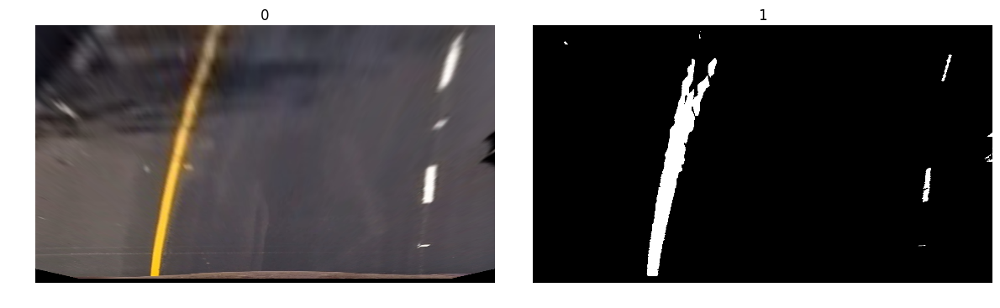

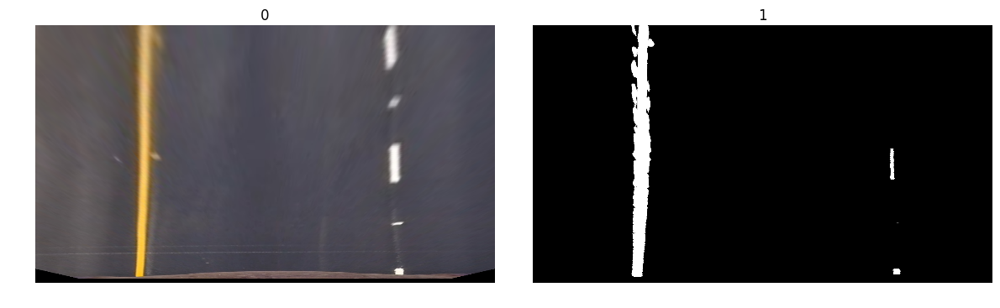

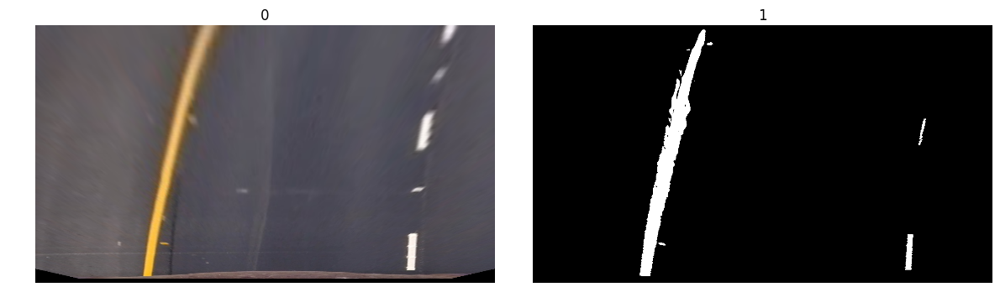

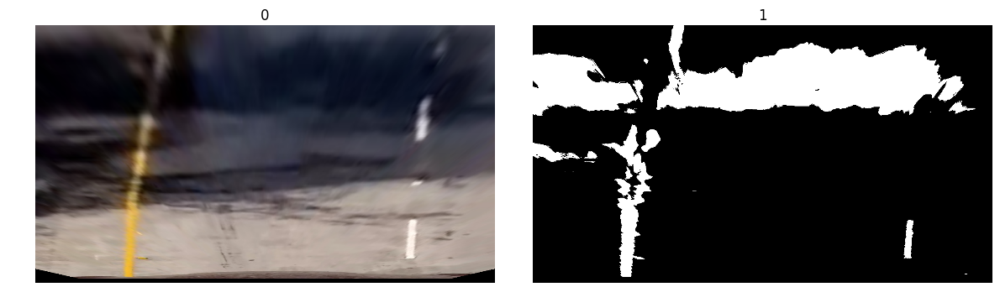

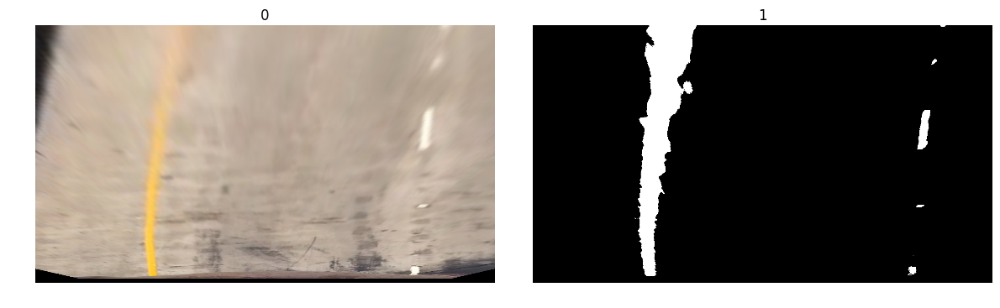

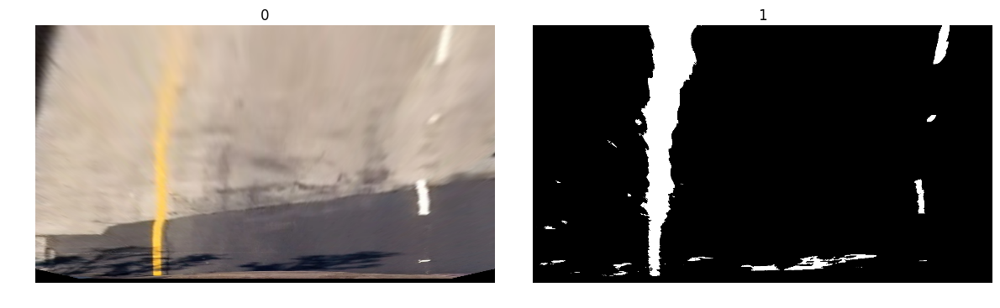

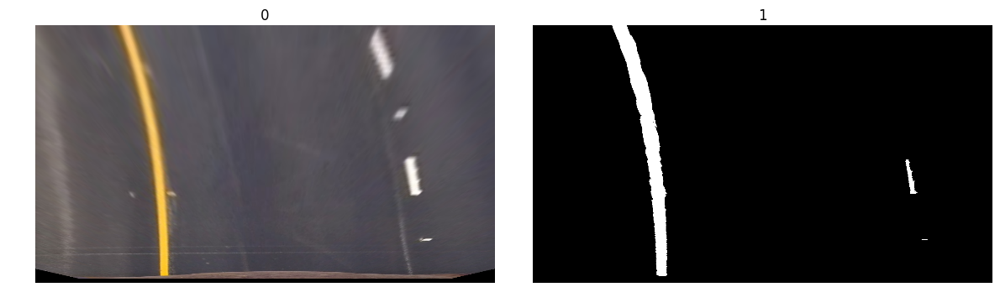

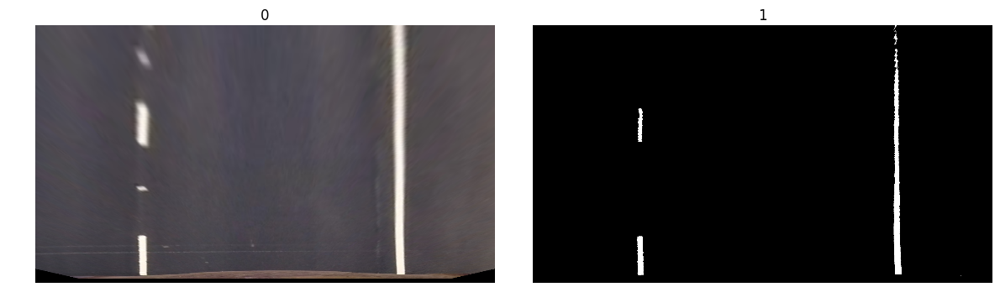

In [11]:
print_figures = {}
count = 0
for i in range(len(undistorted_figures)):
    hls = cv2.cvtColor(undistorted_figures[i], cv2.COLOR_RGB2HLS)
    S = hls[:,:,2]
    
    thresh = (90, 255)
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    
    print_figures[count] = undistorted_figures[i]
    print_figures[count+1] = binary
    plot_figures(print_figures, 1, 2)
    count = 0

On the left is the original image, but in birds eye view with the birds eye view with the binary hls s channel on the right.  The lines are displayed fairly clearly.

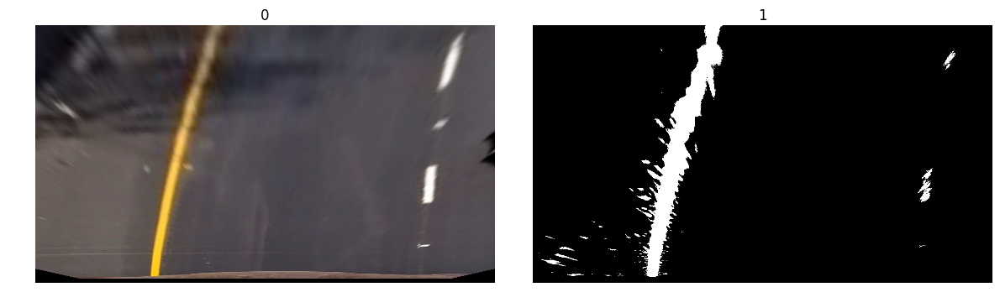

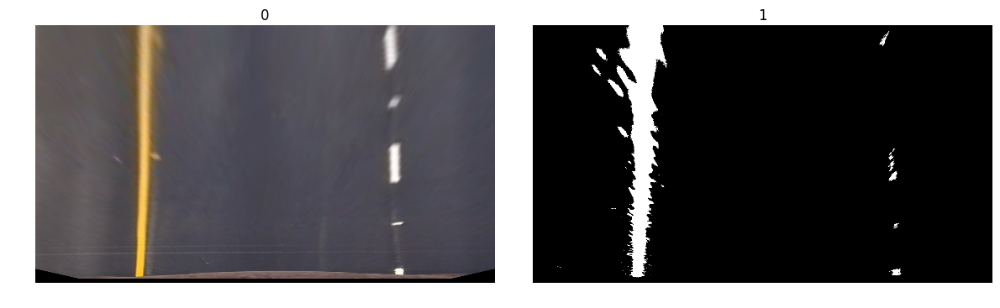

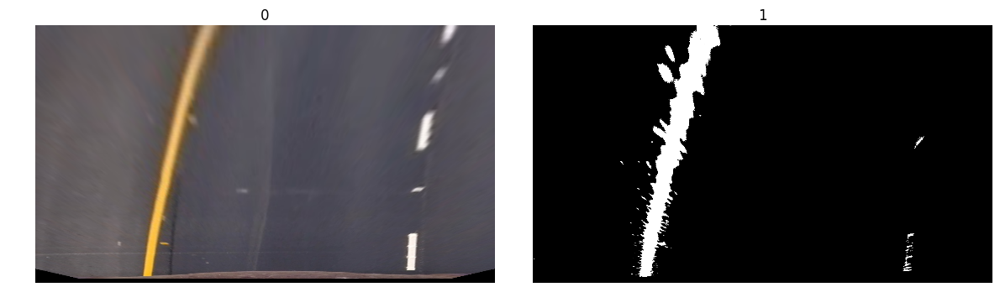

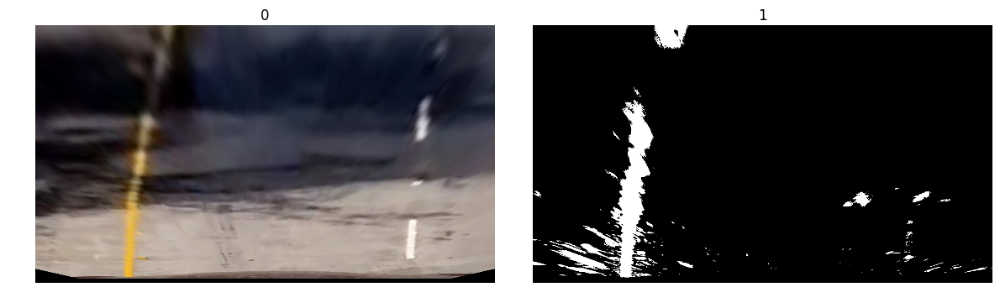

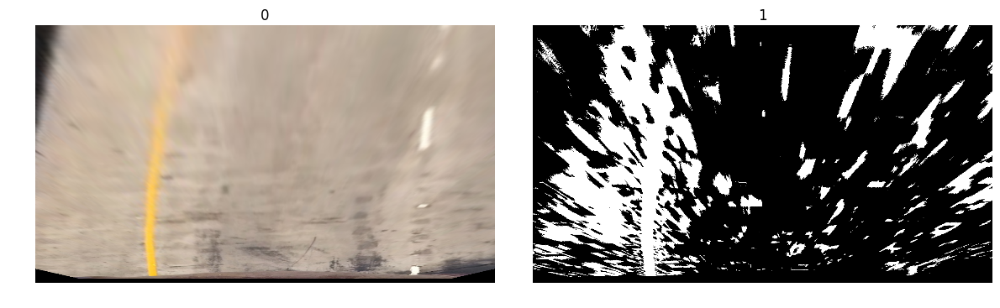

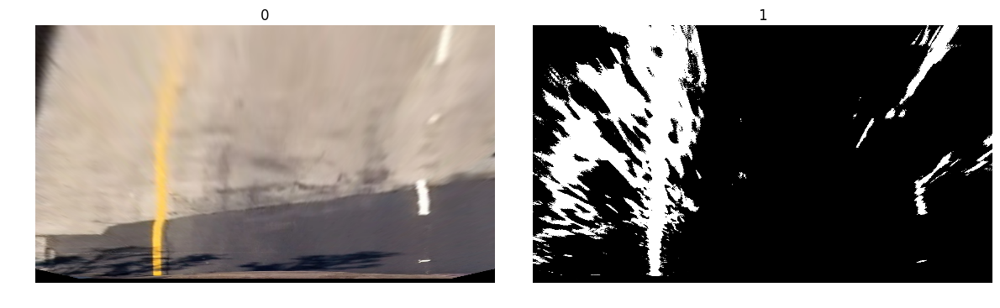

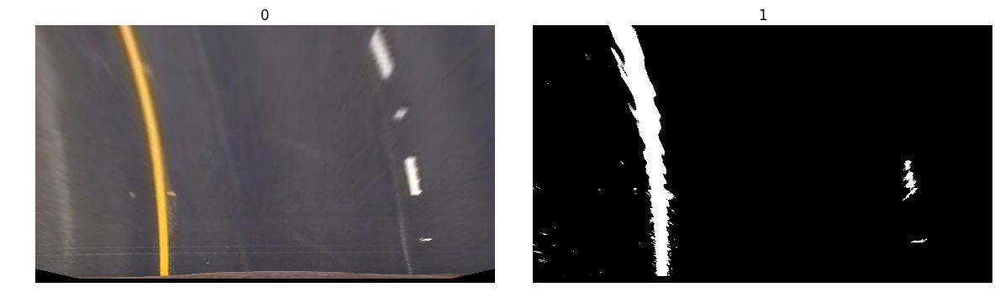

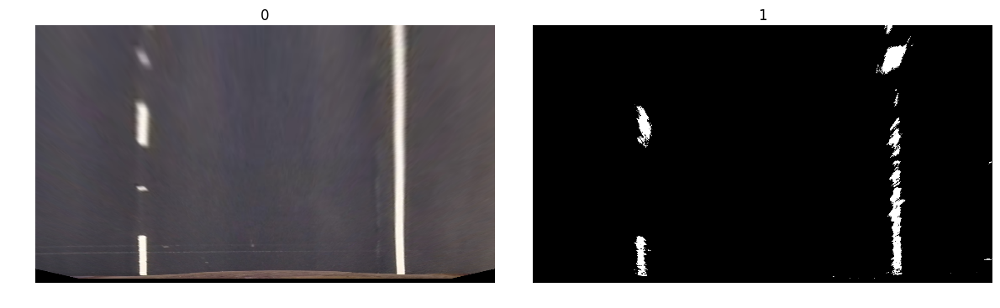

In [12]:
print_figures = {}
count = 0
for i in range(len(undistorted_figures)):
    hls = cv2.cvtColor(undistorted_figures[i], cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    
    thresh = (15, 100)
    binary = np.zeros_like(H)
    binary[(H > thresh[0]) & (H <= thresh[1])] = 1
    
    print_figures[count] = undistorted_figures[i]
    print_figures[count+1] = binary
    plot_figures(print_figures, 1, 2)
    count = 0

On the left is the original image, but in birds eye view with the birds eye view with the binary hls h channel on the right.  The lines are displayed fairly clearly, but not as well as the S channel.

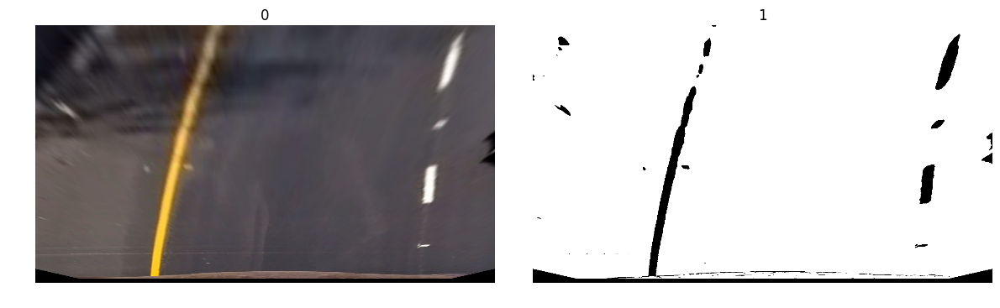

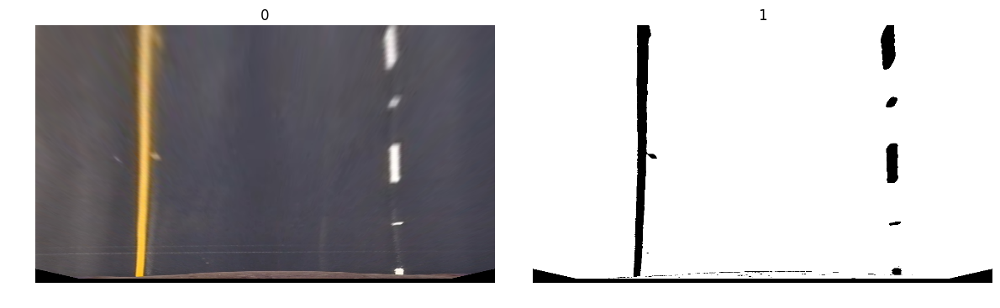

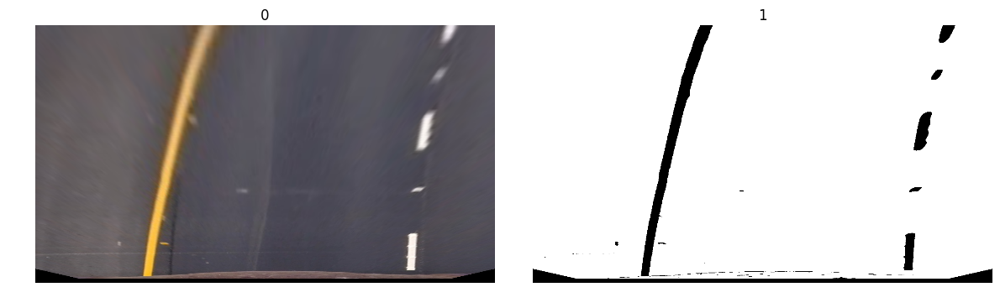

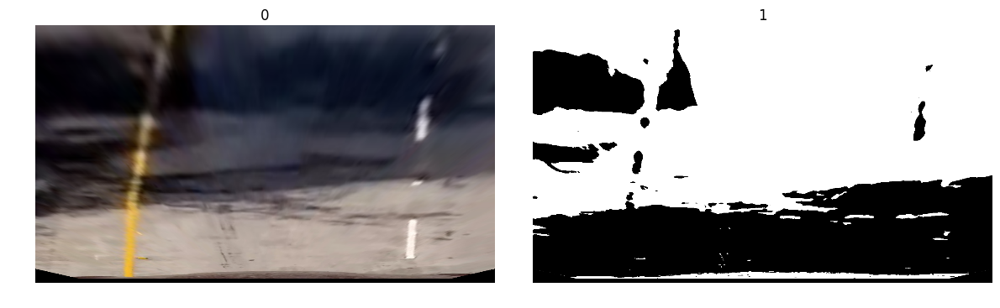

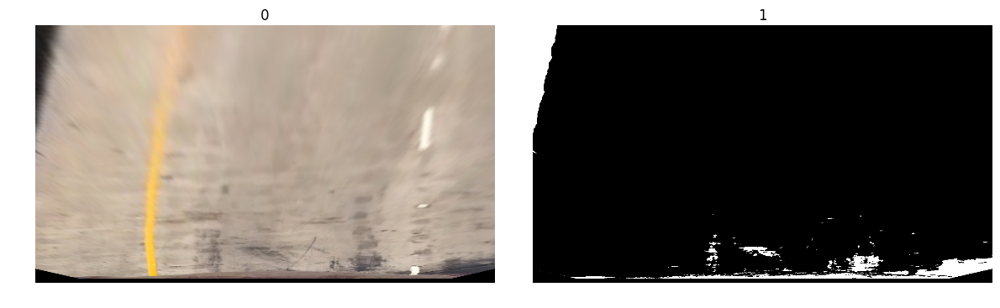

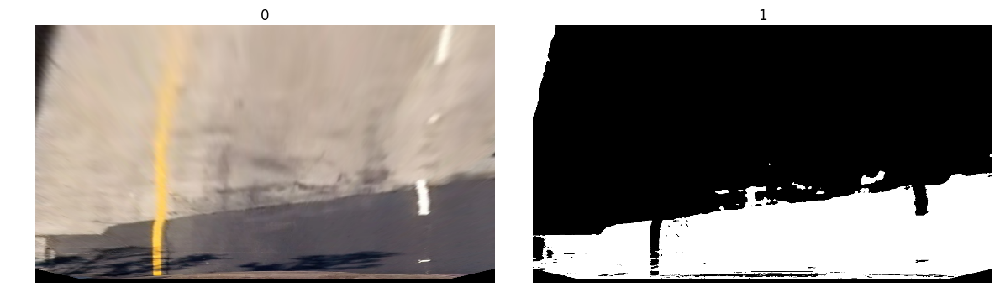

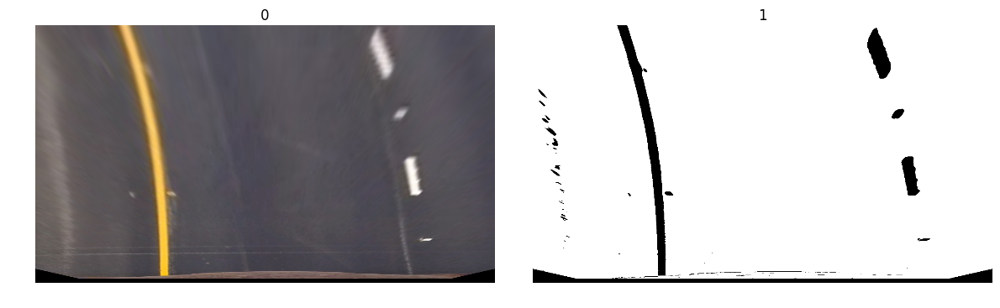

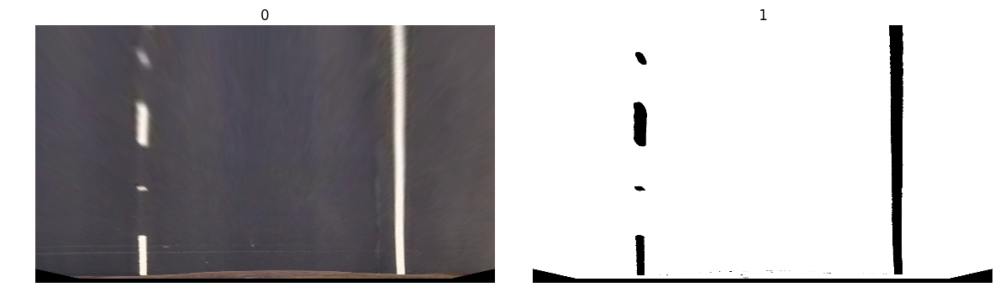

In [13]:
print_figures = {}
count = 0
for i in range(len(undistorted_figures)):
    hls = cv2.cvtColor(undistorted_figures[i], cv2.COLOR_RGB2HLS)
    L = hls[:,:,1]
    
    thresh = (15, 125)
    binary = np.zeros_like(L)
    binary[(L > thresh[0]) & (L <= thresh[1])] = 1
    
    print_figures[count] = undistorted_figures[i]
    print_figures[count+1] = binary
    plot_figures(print_figures, 1, 2)
    count = 0

On the left is the original image, but in birds eye view with the birds eye view with the binary hls L channel on the right. 

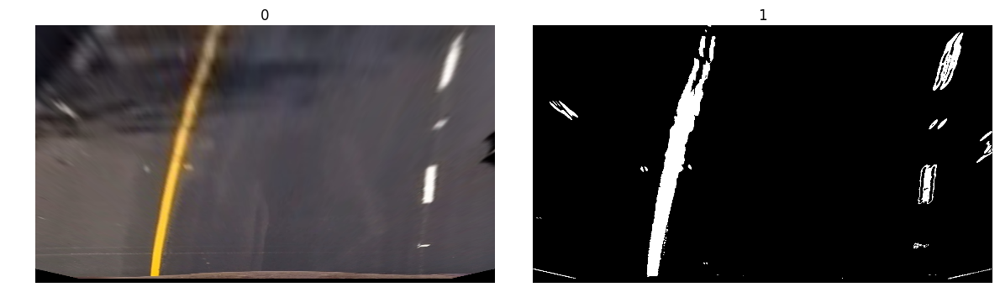

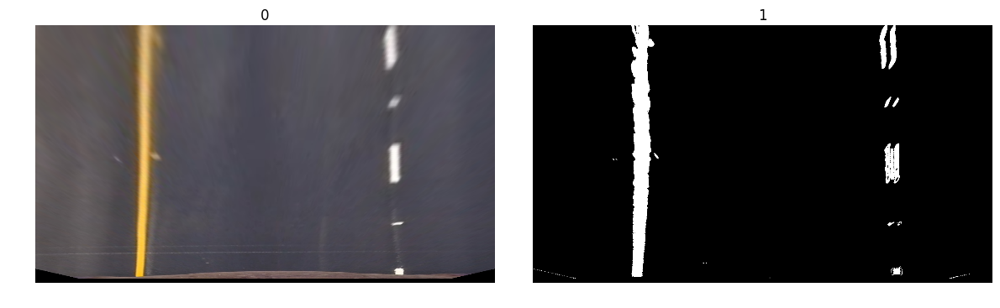

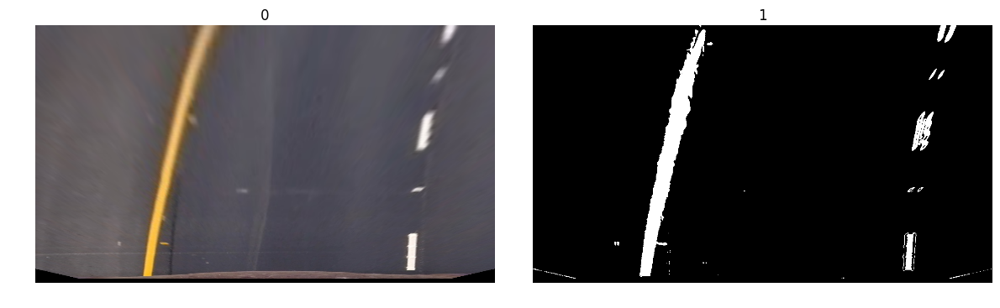

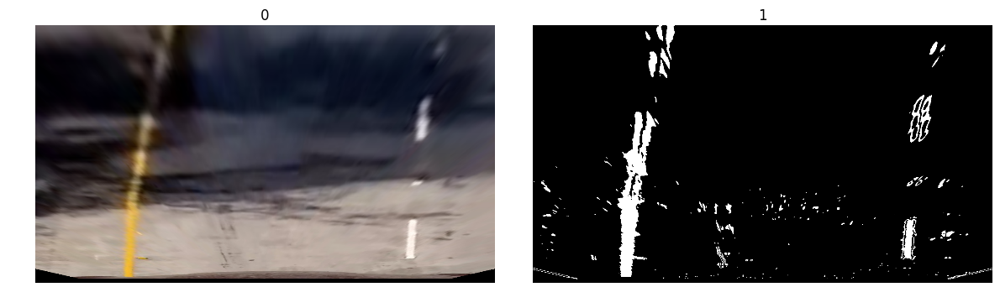

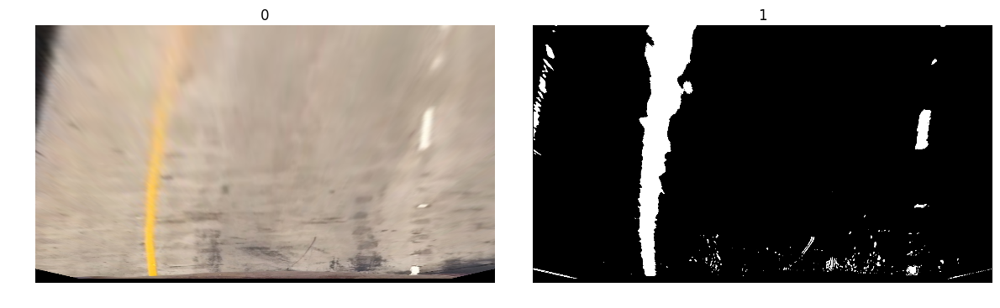

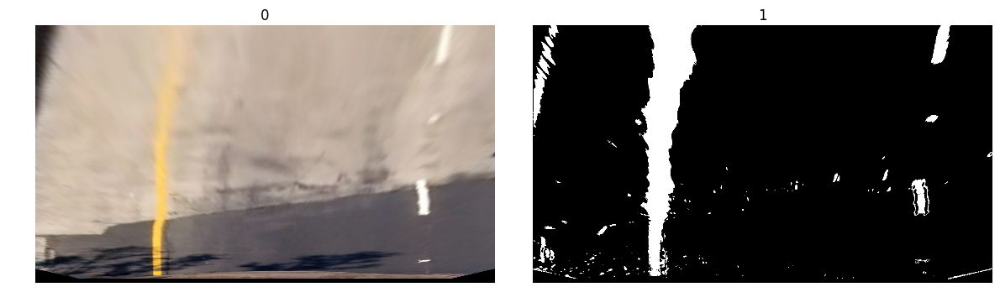

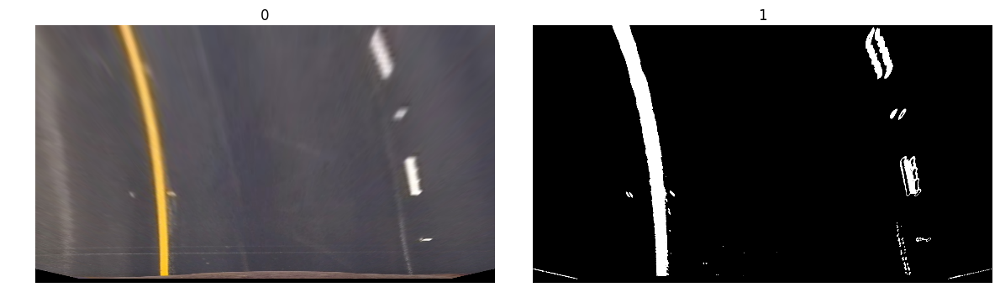

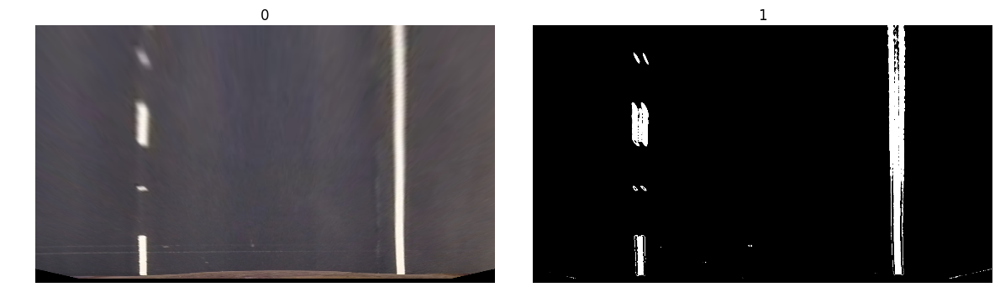

In [14]:
print_figures = {}
count = 0
for i in range(len(undistorted_figures)):
    combined = combine(undistorted_figures[i])
    combined_name = './output_images/combined_binary' + str(i + 1) + '.jpg'
    cv2.imwrite(combined_name, combined)
    
    print_figures[count] = undistorted_figures[i]
    print_figures[count+1] = combined
    plot_figures(print_figures, 1, 2)
    count = 0

On the left is the original image, but in birds eye view with the birds eye view with the binary threshold combination of the previous methods.  The lines are more clear now.

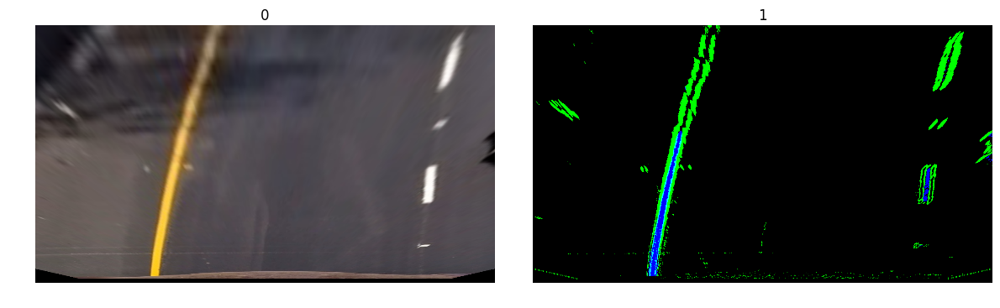

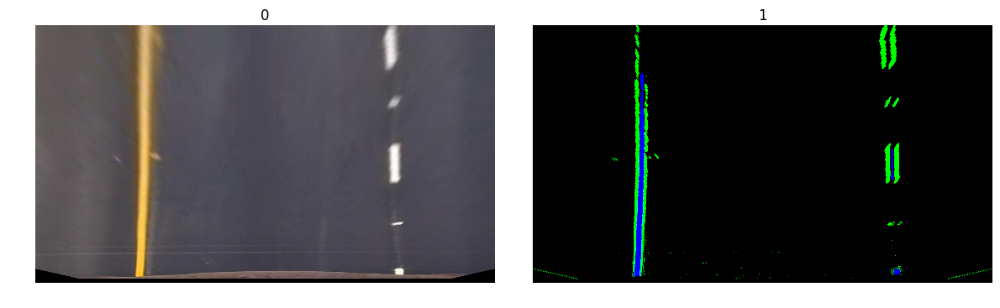

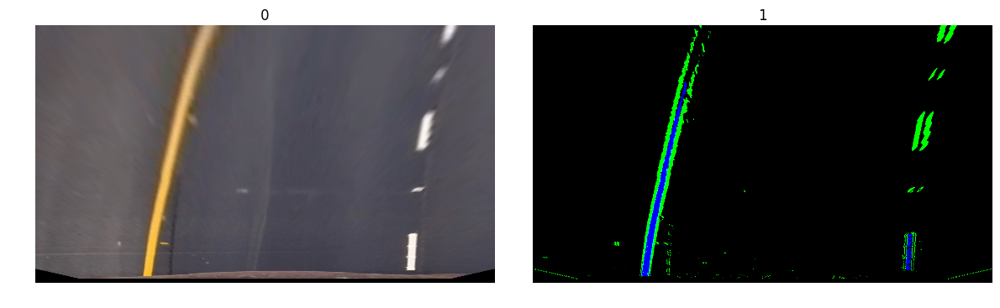

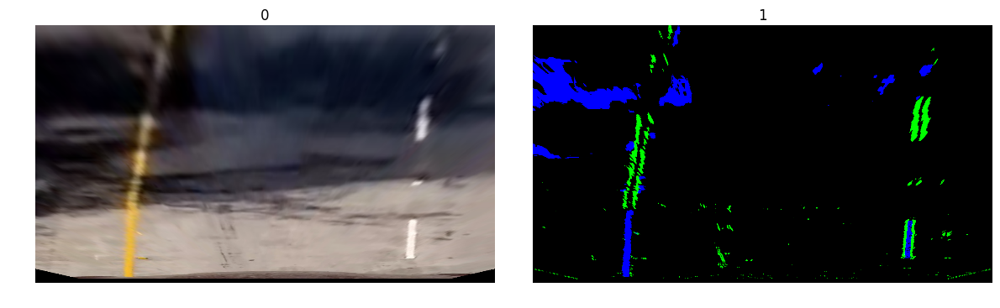

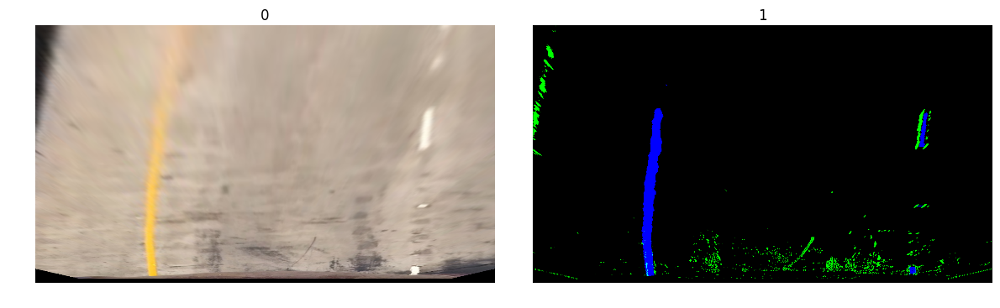

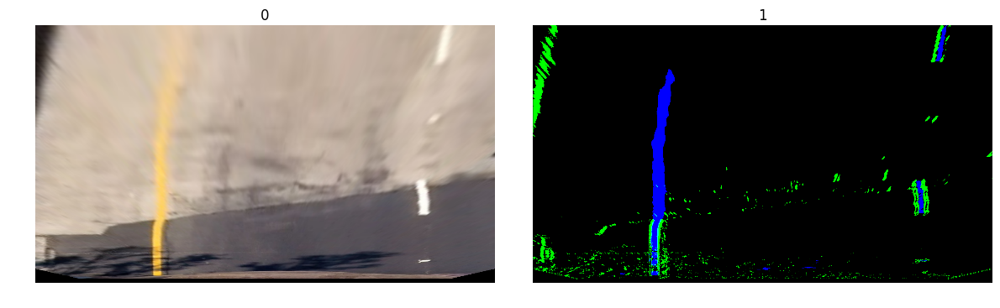

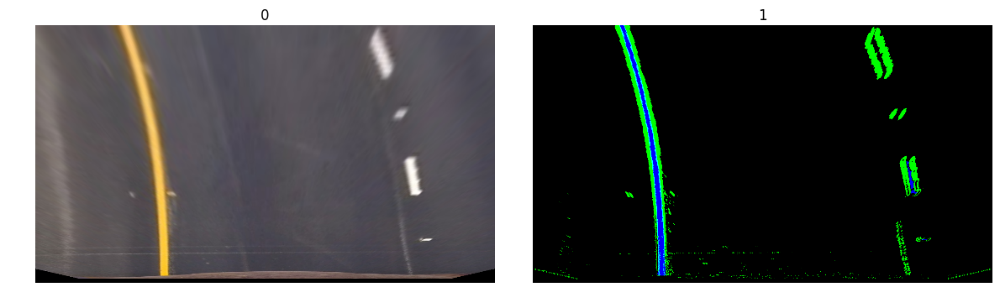

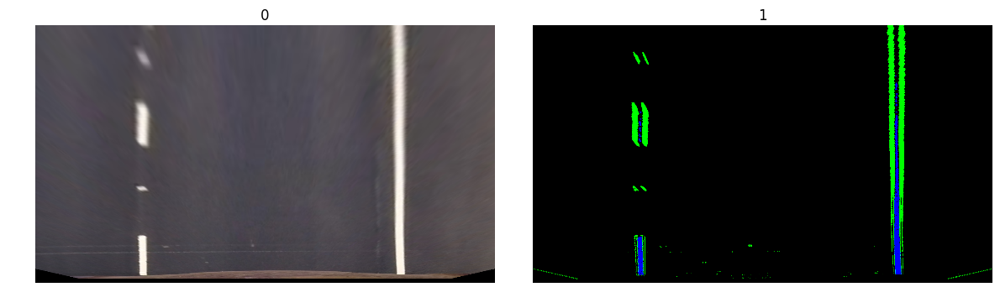

In [15]:
print_figures = {}
count = 0
for i in range(len(undistorted_figures)):
    color_binary = pipeline(undistorted_figures[i])
    print_figures[count] = undistorted_figures[i]
    print_figures[count+1] = color_binary
    plot_figures(print_figures, 1, 2)
    count = 0

This is an example of a color pipeline doing various threshholding using some of the previous methods and using color channels.

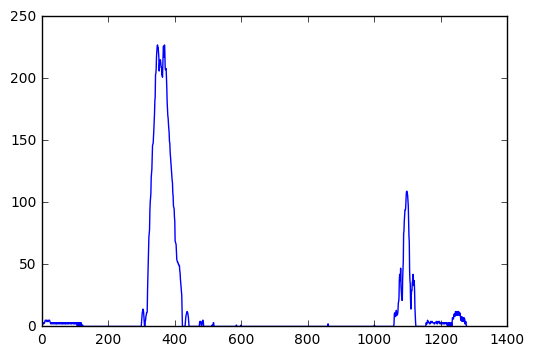

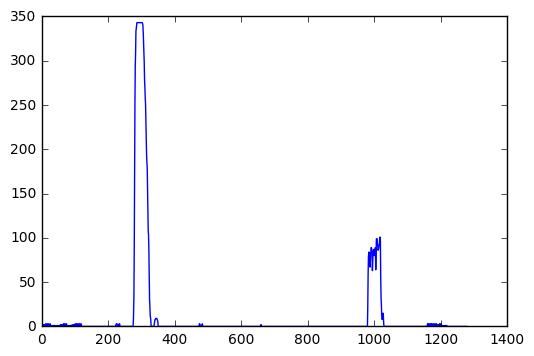

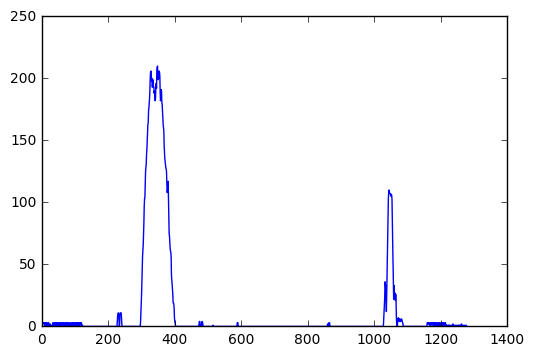

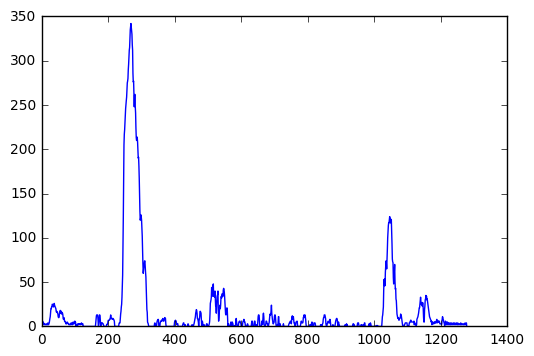

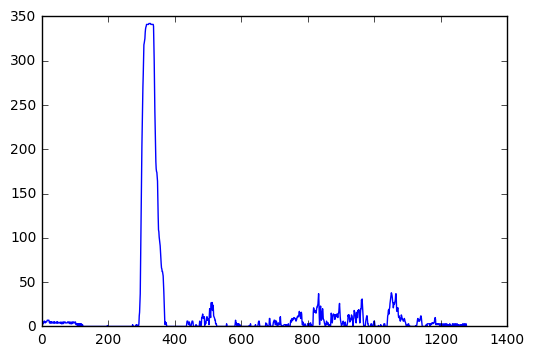

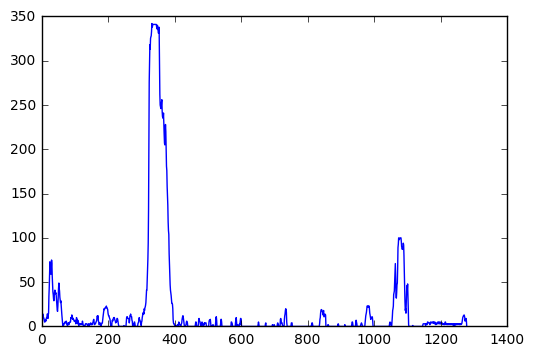

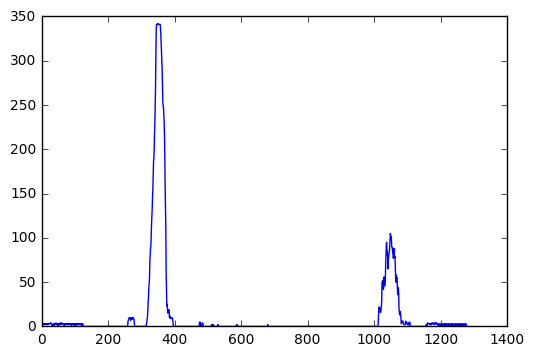

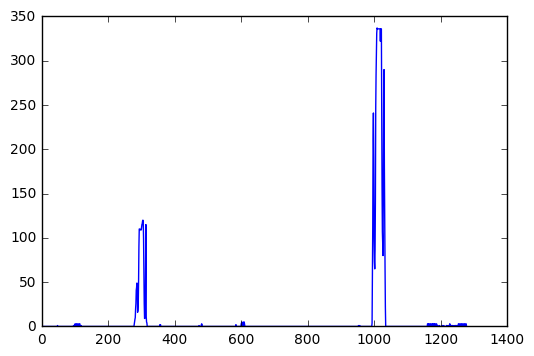

In [16]:
for i in range(len(undistorted_figures)):
    combined = combine(undistorted_figures[i])
    combined_name = './output_images/graph' + str(i + 1) + '.jpg'
    cv2.imwrite(combined_name, combined)    
    
    img = np.copy(combined)
    shape_by_two = int(img.shape[0]/2)
    histogram = np.sum(img[shape_by_two:,:], axis=0)
    plt.figure()
    plt.plot(histogram)

The gra-hs above clearly show two peaks pretty clearly.  This histogram with the combined methods from above should make it easy to detect in my images and video.

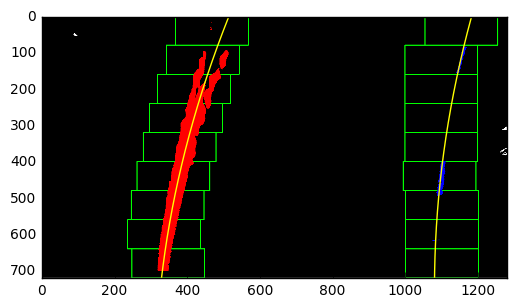

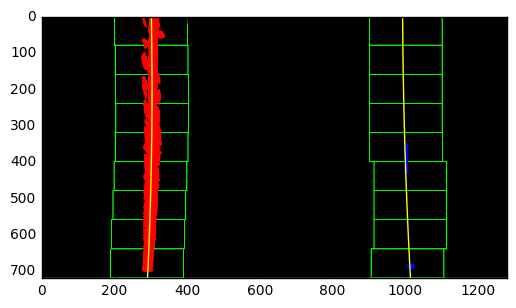

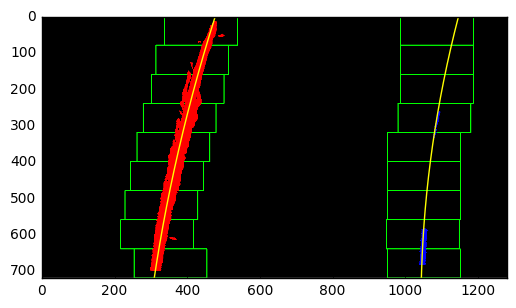

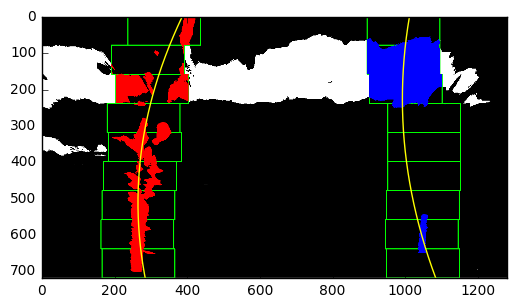

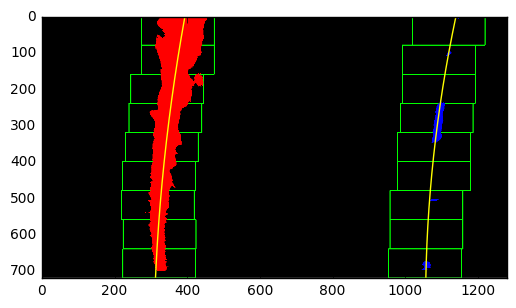

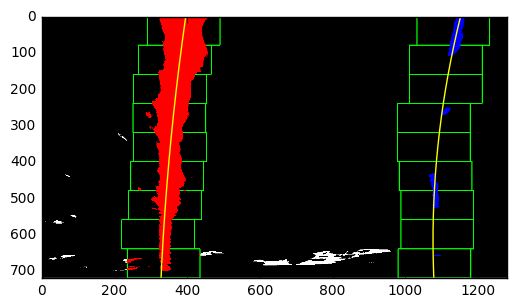

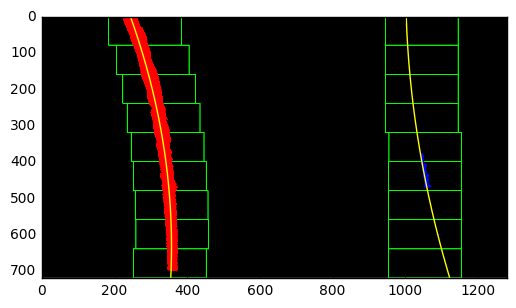

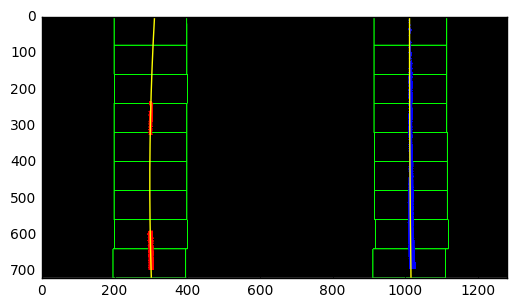

In [17]:
for i in range(len(undistorted_figures)):
    binary_warped = hls_select(undistorted_figures[i], thresh=(90, 255))
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    combined_name = './output_images/windows' + str(i + 1) + '.jpg'
    cv2.imwrite(combined_name, out_img)
    
    plt.figure()
    plt.imshow(out_img)
   
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

The images display above show windows that move along the lane lines found up to 9 windows within a margin of 100 pixels.  This helps find lane line centers and I used it in my process method for images and video.

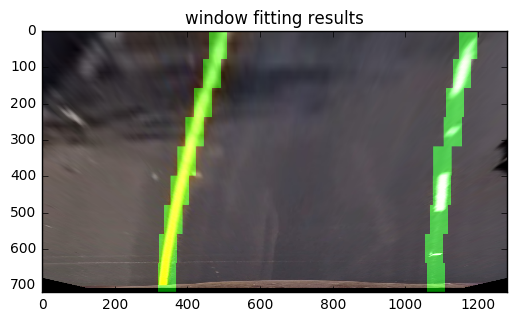

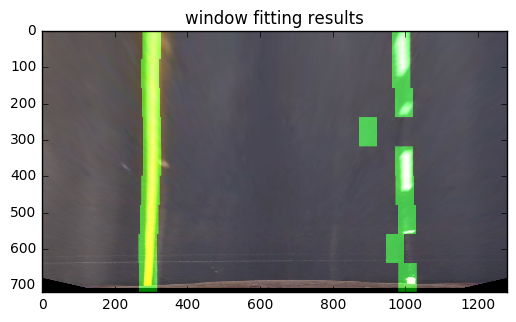

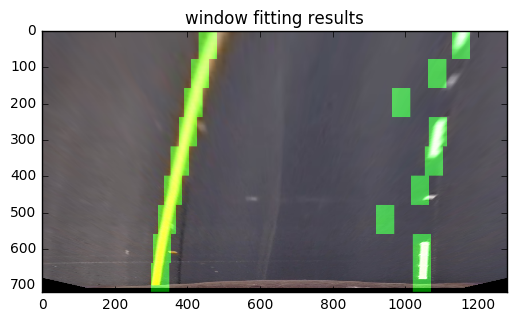

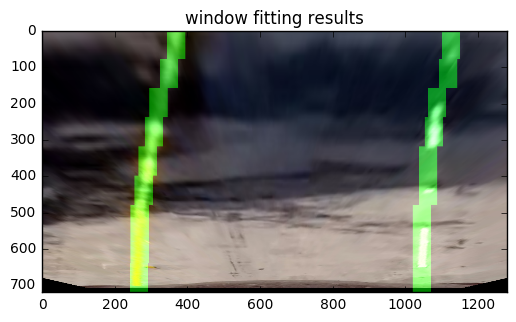

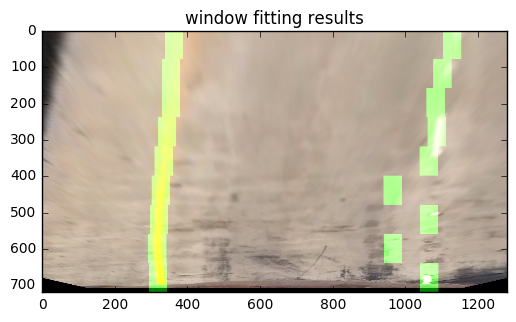

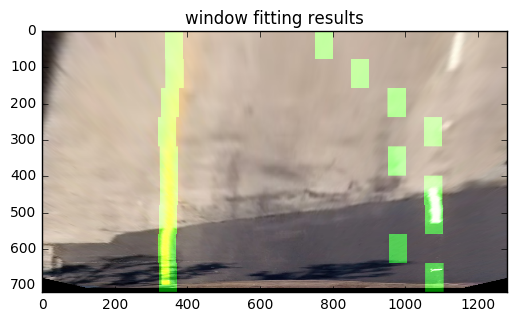

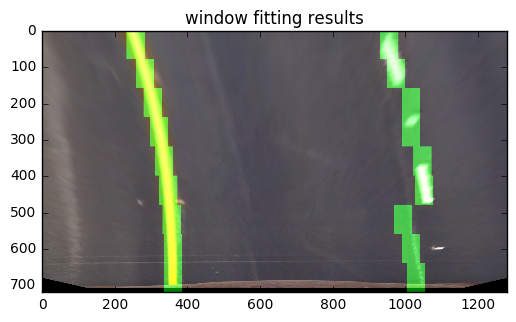

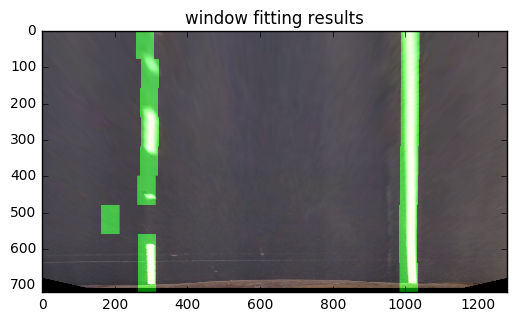

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import cv2

# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

for i in range(len(undistorted_figures)):
    warped = combine(undistorted_figures[i])
    
    window_centroids = find_window_centroids(warped, window_width, window_height, margin)

    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channle 
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage = np.array(cv2.merge((warped,warped,warped)),np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(undistorted_figures[i], 1, template, 0.5, 0.0) # overlay the orignal road image with window results

    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)

    # Display the final results
    plt.figure()
    plt.imshow(output)
    plt.title('window fitting results')
    plt.show()

In this images above we use the windows from the previous cell and then apply a mask which can help later in drawing lane lines.

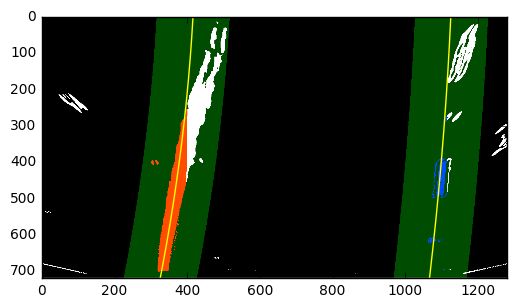

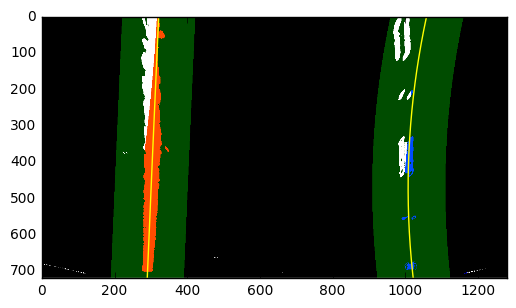

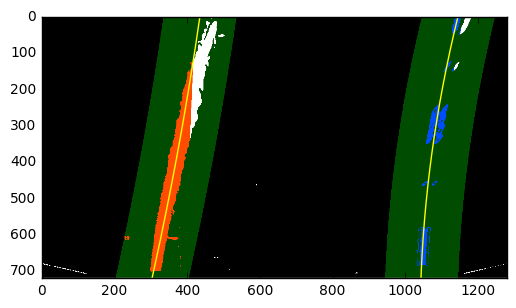

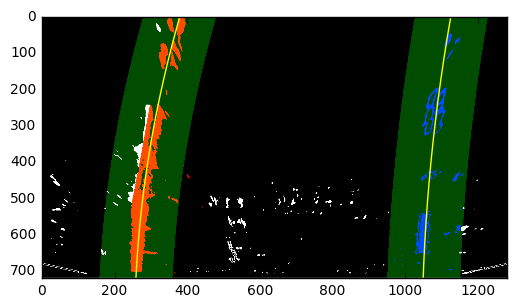

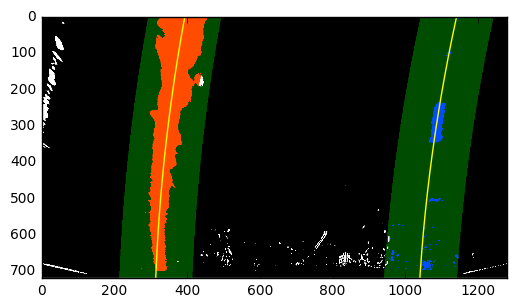

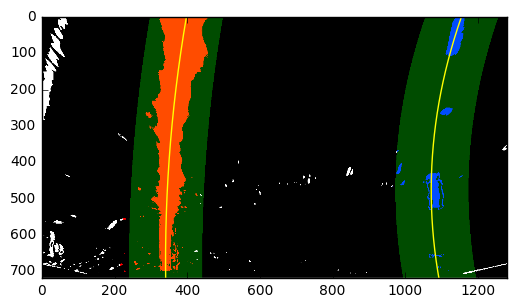

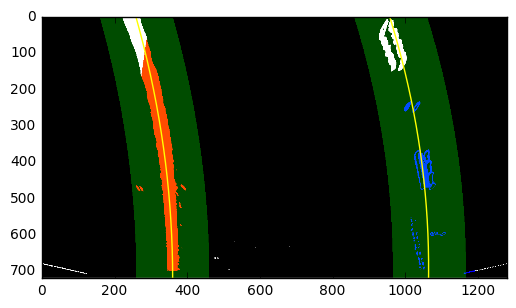

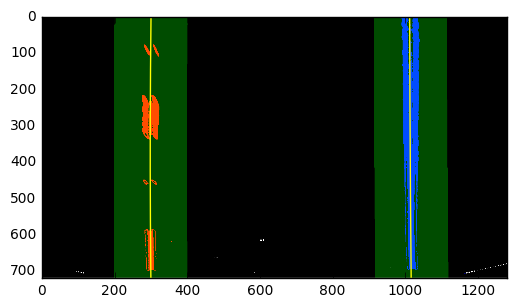

In [19]:
for i in range(len(undistorted_figures)):
    binary_warped = combine(undistorted_figures[i])
#     print(binary_warped.shape)
    
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                      (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                       (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
#     print(leftx.shape)
#     print(lefty.shape)
    
#     print(rightx.shape)
#     print(righty.shape)
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
#     print(ploty.shape)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#     print(left_fitx.shape)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
#     measure_curve(ploty,leftx,lefty,rightx,righty)
    
    plt.figure()
    plt.imshow(result)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)

In the images above that are a perspective transform I overlay lane lines with a mask and a center line.  I also clearly mark left lane with red and right with blue.  These were drawn using polynomial fitting.

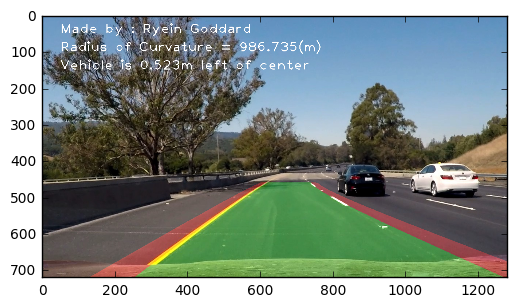

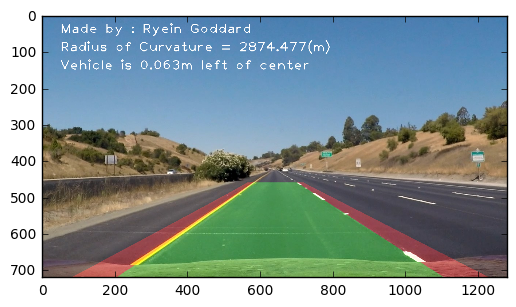

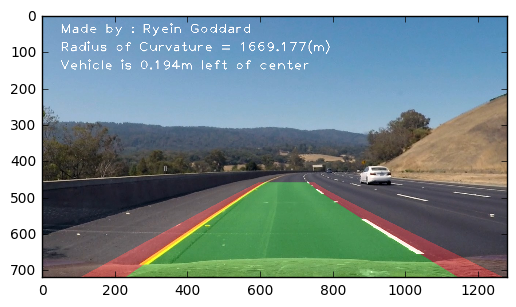

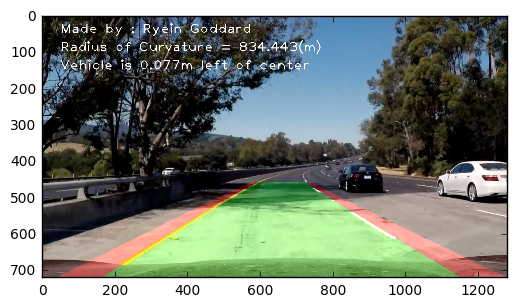

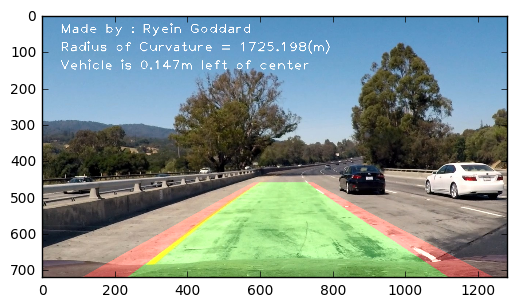

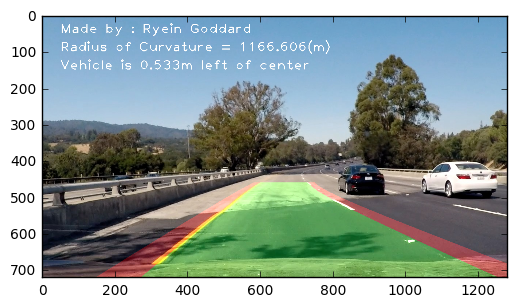

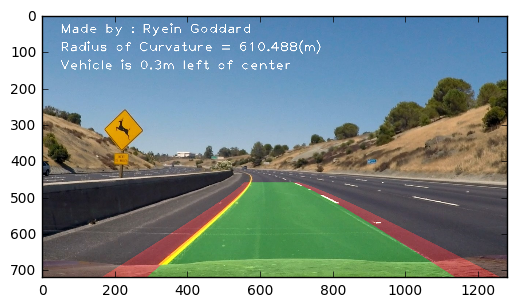

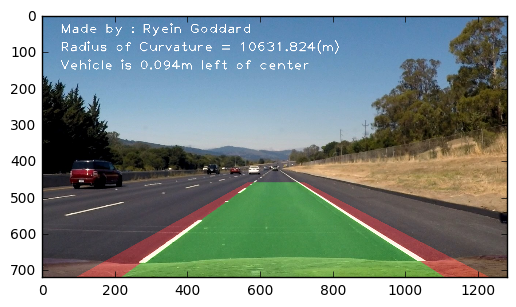

In [20]:
for i in range(len(undistorted_figures)):
    binary_warped = combine(undistorted_figures[i])
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]    
    
    warped = binary_warped
    
    nonzero = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                      (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                       (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
#     print(ploty.shape)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
#     print(left_fitx.shape)
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (255,0, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (255,0, 0))
    
    result = cv2.addWeighted(undistorted_figures[i], 1, window_img, 0.3, 0)
    
#     plt.figure()
#     plt.imshow(result)
#     plt.plot(left_fitx, ploty, color='yellow')
#     plt.plot(right_fitx, ploty, color='yellow')
#     plt.xlim(0, 1280)
#     plt.ylim(720, 0)
        
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(color_warp, np.int_([left_line_pts]), (255,0, 0))
    cv2.fillPoly(color_warp, np.int_([right_line_pts]), (255,0, 0))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (original_figures[i].shape[1], original_figures[i].shape[0])) 
    
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
#     print(left_curverad, right_curverad)
    
    # Combine the result with the original image
    result = cv2.addWeighted(original_figures[i], 1, newwarp, 0.3, 0)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
#     print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m    
    
    # Calculate offset of car
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    center_diff = (camera_center - warped.shape[1] / 2) * xm_per_pix
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
    # Display radius of curvature and vehicle offset
    cv2.putText(result, 'Made by : Ryein Goddard ', (50, 50), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    # Display radius of curvature and vehicle offset
    cv2.putText(result, 'Radius of Curvature = ' + str(round(left_curverad, 3)) + '(m)', (50, 100), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(center_diff, 3))) + 'm ' + side_pos + ' of center', (50, 150), cv2.FONT_HERSHEY_PLAIN, 
                2.5, (255, 255, 255), 2)    
    
    combined_name = './output_images/plotted' + str(i + 1) + '.jpg'
    cv2.imwrite(combined_name, result)
    
    plt.figure()
    plt.imshow(result)

In the images above we apply all the methods from before with the addition of an unwarpping our line calculations to apply them to the original image since they were drawn on the warped and region of interest perspective transform image. This is also the first time I calculate curvature and vehicle position between the polynomials. 

<h1>Pipeline for Videos</h1>

In [21]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
# for i in range(len(undistorted_figures)):
def process(image):
    img = undistort(image)
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    warped = cv2.cvtColor(warped, cv2.COLOR_BGR2RGB)

    binary_warped = combine(warped)
    
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    margin = 100
    
    global left_fit, right_fit, left_poly_list, right_poly_list
    if (left_fit, right_fit) == (None,None):
        # Assuming you have created a warped binary image called "binary_warped"
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[int(binary_warped.shape[0]/2):,:], axis=0)
        # Create an output image to draw on and  visualize the result
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Choose the number of sliding windows
        nwindows = 9
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
                
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        #save frame data for future
        left_poly_list = np.array([left_fit])
        right_poly_list = np.array([right_fit])
    else:
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
                          (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                           (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
    
#     left_poly_list = np.array([left_fit])
#     right_poly_list = np.array([right_fit])

    #Average poly coefficient up to the last 10 frames
    left_poly_list = np.concatenate((left_poly_list,[left_fit]),axis=0)[-5:]
    right_poly_list = np.concatenate((right_poly_list,[right_fit]),axis=0)[-5:]
    left_fit = np.average(left_poly_list,axis=0)
    right_fit = np.average(right_poly_list,axis=0)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warped = binary_warped    
    
    out_img = np.dstack((warped, warped, warped))*255
    out_img[lefty, leftx] = [255,0,0]
    out_img[righty,rightx] = [0,0,255] 
#     nonzero = warped.nonzero()
#     nonzeroy = np.array(nonzero[0])
#     nonzerox = np.array(nonzero[1])
    
#     left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & 
#                       (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
#     right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
#                        (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
#     leftx = nonzerox[left_lane_inds]
#     lefty = nonzeroy[left_lane_inds] 
#     rightx = nonzerox[right_lane_inds]
#     righty = nonzeroy[right_lane_inds]
    
#     left_fit = np.polyfit(lefty, leftx, 2)
#     right_fit = np.polyfit(righty, rightx, 2)
    
#     # Generate x and y values for plotting
#     ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
# #     print(ploty.shape)
#     left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
# #     print(left_fitx.shape)
#     right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw on and an image to show the selection window
    
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
#     out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
#     out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
#     out_img[lefty, leftx] = [255,0,0]
#     out_img[righty,rightx] = [0,0,255]
    
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (255,0, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (255,0, 0))
    
    result = cv2.addWeighted(image, 1, window_img, 0.3, 0)
        
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    cv2.fillPoly(color_warp, np.int_([left_line_pts]), (255,0, 0))
    cv2.fillPoly(color_warp, np.int_([right_line_pts]), (255,0, 0))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
#     print(left_curverad, right_curverad)
    
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
#     print(left_curverad, 'm', right_curverad, 'm')
    # Example values: 632.1 m    626.2 m    
    
    # Calculate offset of car
    camera_center = (left_fitx[-1] + right_fitx[-1]) / 2
    center_diff = (camera_center - warped.shape[1] / 2) * xm_per_pix
    side_pos = 'left'
    if center_diff <= 0:
        side_pos = 'right'
    cv2.putText(result, 'Made by : Ryein Goddard ', (50, 50), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    # Display radius of curvature and vehicle offset
    cv2.putText(result, 'Radius of Curvature = ' + str(round(left_curverad, 3)) + '(m)', (50, 100), cv2.FONT_HERSHEY_PLAIN, 2.5,
                (255, 255, 255), 2)
    cv2.putText(result, 'Vehicle is ' + str(abs(round(center_diff, 3))) + 'm ' + side_pos + ' of center', (50, 150), cv2.FONT_HERSHEY_PLAIN, 
                2.5, (255, 255, 255), 2)    
    
    return result

Here is our process function which is a combination of all the methods above.

In [22]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
project_output = 'project_vid.mp4'
clip1 = VideoFileClip('project_video.mp4')
left_fit, right_fit = None, None
project_clip = clip1.fl_image(process)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_vid.mp4
[MoviePy] Writing video project_vid.mp4


100%|█████████▉| 1260/1261 [03:05<00:00,  6.73it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_vid.mp4 

CPU times: user 6min 45s, sys: 38.7 s, total: 7min 23s
Wall time: 3min 6s


In [23]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
project_output = 'challenge_vid.mp4'
clip1 = VideoFileClip('challenge_video.mp4')
left_fit, right_fit = None, None
project_clip = clip1.fl_image(process)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video challenge_vid.mp4
[MoviePy] Writing video challenge_vid.mp4


100%|██████████| 485/485 [01:06<00:00,  7.32it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_vid.mp4 

CPU times: user 2min 27s, sys: 14.3 s, total: 2min 41s
Wall time: 1min 7s


<h1>Discussion</h1>

Right now I think for the challenge in the video presented this works 99% of the frames.  It could be further improved by computing a moving average and remembering previous frames.

I think this method isn't robust enough to deal with heavy shadows and probably won't work at all during the night, snow, or heavy rain.